In [2]:
!nvidia-smi

Sat Jul  8 16:18:17 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    25W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
import os
import zipfile
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import imageio
import shutil
import pandas as pd
from tensorflow.keras import Model
from tensorflow.keras import layers
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import concatenate
from tensorflow.keras import layers
from tensorflow.keras import models
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Concatenate, Dropout, BatchNormalization
from tensorflow.keras.models import Model
from PIL import Image
from IPython.display import clear_output

In [4]:
import random
import cv2
import albumentations as A

In [ ]:
!unzip  '/content/drive/My Drive/hands_dataset.zip'

In [6]:
import os

def remove_ds_store_files(directory):
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file == '.DS_Store' or file=='.DS_Store.png':
                file_path = os.path.join(root, file)
                os.remove(file_path)
                print(f"Deleted: {file_path}")

# Specify the directory path
directory_path = 'Dataset'

# Call the function to remove .DS_Store files
remove_ds_store_files(directory_path)

Deleted: Dataset/.DS_Store
Deleted: Dataset/images/.DS_Store
Deleted: Dataset/masks/.DS_Store


In [7]:
#add file extension if missing

def check_and_rename_files(directory):
  """Checks if any image files are missing a .png extension and renames the files if necessary.

  Args:
    directory: The directory to check.
  """

  for root, directories, files in os.walk(directory):
    for file in files:
      if file.endswith(".png") or file.endswith('.jpg'):
        continue
      else:
        new_file_name = file + ".png"
        os.rename(os.path.join(root, file), os.path.join(root, new_file_name))



directory = "./Dataset/masks"
check_and_rename_files(directory)

print("Files renamed successfully!")




Files renamed successfully!


In [8]:
# convert all png mask files to jpeg
def convert_png_to_jpg(file_path):
  """Converts a PNG file to a JPG file.

  Args:
    file_path: The path to the PNG file.
  """

  image = Image.open(file_path)
  image.save(file_path[:-3] + "jpg")
  os.remove(file_path)



directory = "./Dataset/masks"

for root, directories, files in os.walk(directory):
  for file in files:
    if file.endswith(".png"):
      convert_png_to_jpg(os.path.join(root, file))

print("PNG files converted to JPG files!")


PNG files converted to JPG files!


In [9]:
# split dataset to train test val

dataset_dir = 'Dataset'  # Path to the dataset directory
output_dir = 'split_dataset'  # Path to the output directory for split dataset

# Create the output directories if they don't exist
os.makedirs(output_dir, exist_ok=True)
os.makedirs(os.path.join(output_dir, 'train', 'images'), exist_ok=True)
os.makedirs(os.path.join(output_dir, 'train', 'masks'), exist_ok=True)
os.makedirs(os.path.join(output_dir, 'test', 'images'), exist_ok=True)
os.makedirs(os.path.join(output_dir, 'test', 'masks'), exist_ok=True)
os.makedirs(os.path.join(output_dir, 'val', 'images'), exist_ok=True)
os.makedirs(os.path.join(output_dir, 'val', 'masks'), exist_ok=True)

# Set the split ratios
train_ratio = 0.8
test_ratio = 0.1
val_ratio = 0.1

# Iterate through the images directory in the dataset
for image_file in os.listdir(os.path.join(dataset_dir, 'images')):
    # Get the image file path
    try:
      image_path = os.path.join(dataset_dir, 'images', image_file)

      # Determine the split destination based on random selection
      rand_val = random.uniform(0, 1)
      if rand_val < train_ratio:
          split_dir = 'train'
      elif rand_val < train_ratio + test_ratio:
          split_dir = 'test'
      else:
          split_dir = 'val'

      # Create the corresponding directories in the split dataset
      split_image_path = os.path.join(output_dir, split_dir, 'images', image_file)
      split_mask_path = os.path.join(output_dir, split_dir, 'masks', image_file)

      # Copy the image file to the split dataset directory
      shutil.copy(image_path, split_image_path)

      # Copy the corresponding mask file to the split dataset directory
      mask_file = image_file.split('.')[0] + '.jpg'
      mask_path = os.path.join(dataset_dir, 'masks', mask_file)
      split_mask_path = os.path.join(output_dir, split_dir, 'masks', mask_file)
      shutil.copy(mask_path, split_mask_path)
    except:
      continue
    #print(f"Moved files: {image_path}, {mask_path} -> {split_image_path}, {split_mask_path}")


In [10]:
import os

images_dir = './split_dataset/train/images'
masks_dir = './split_dataset/train/masks'

# Get the list of image files
image_files = os.listdir(images_dir)

# Iterate through each image file to check and remove files with missing masks
for image_file in image_files:
    image_name, image_ext = os.path.splitext(image_file)
    mask_file = image_name + '.jpg'
    mask_path = os.path.join(masks_dir, mask_file)

    if not os.path.isfile(mask_path):
        os.remove(os.path.join(images_dir,image_file))
        print(f"Missing mask file for image: {image_file}")


In [11]:
# Visualization function
def display(display_list):
    plt.figure(figsize=(15, 15))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

1291
1291
1.jpg
1.jpg


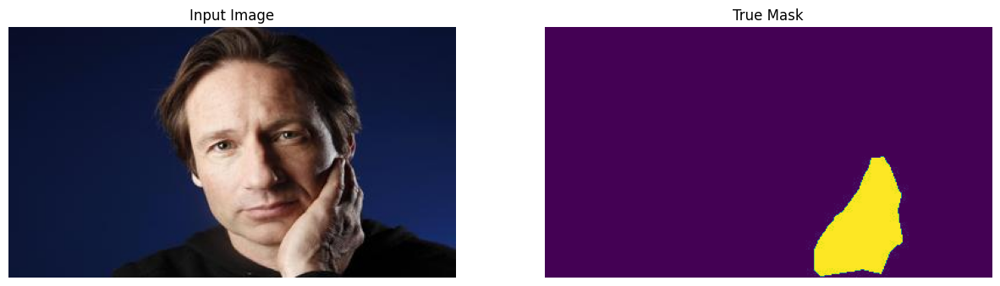

10.jpg
10.jpg


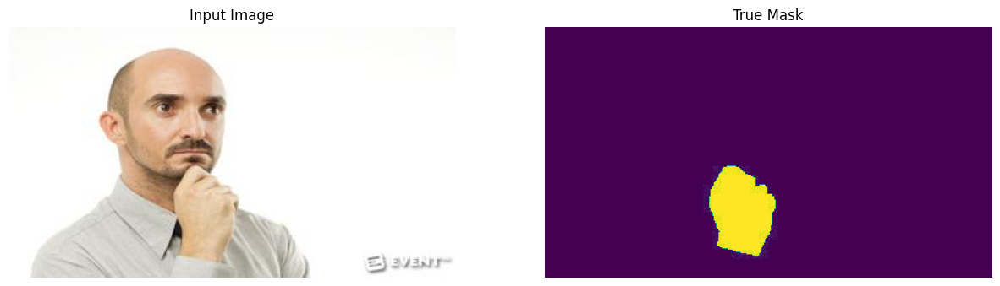

100.jpg
100.jpg


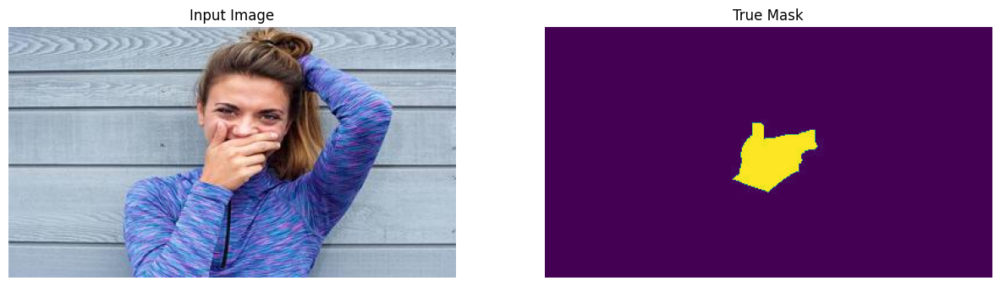

101.jpg
101.jpg


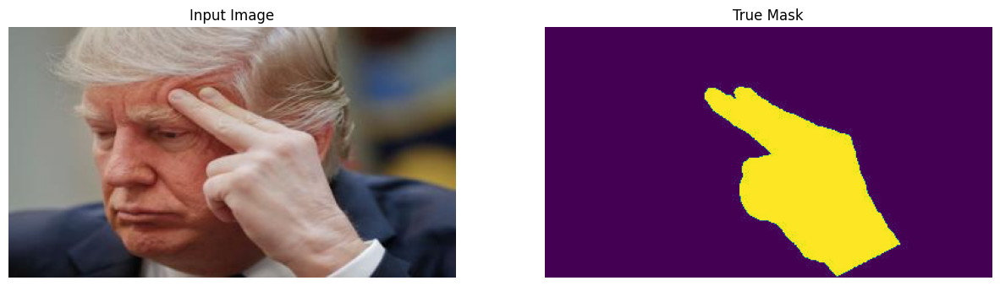

103.jpg
103.jpg


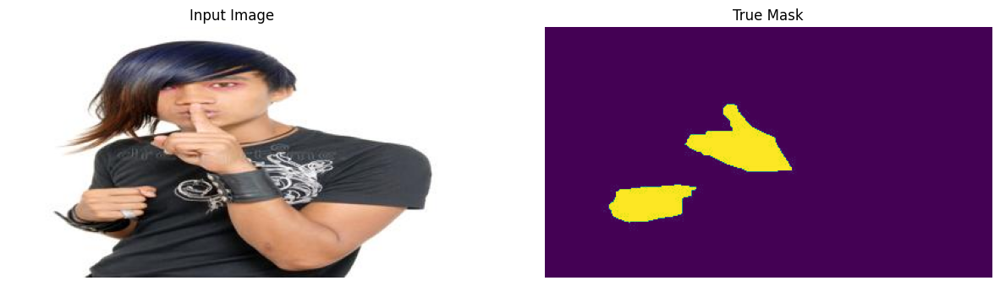

In [12]:
# Visualize sample images from train
i=0
images = os.listdir('./split_dataset/train/images')
masks = os.listdir('./split_dataset/train/masks')
print(len(images))
print(len(masks))
images = sorted(images)
masks = sorted(masks)
for image, mask in zip(images, masks):
    print(image)
    print(mask)
    img = cv2.imread(os.path.join('/content/split_dataset/train/images', image))
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    m = cv2.imread(os.path.join('/content/split_dataset/train/masks', mask))
    m = cv2.cvtColor(m, cv2.COLOR_BGR2GRAY)
    m = tf.expand_dims(m, axis=-1)
    display([rgb, m])
    i+=1
    if i == 5:
        break


In [17]:
train_images = os.listdir('./split_dataset/train/images')
val_images=os.listdir('./split_dataset/val/images')
test_images = os.listdir('./split_dataset/test/images')

In [18]:
print("train data size",len(train_images))
print("val data size",len(val_images))
print("test data size",len(test_images))

train data size 1291
val data size 145
test data size 155


In [19]:
#Setting up the dataset for model training with data augmentation on the fly

train_images = os.listdir('./split_dataset/train/images')

X_train = []
y_train = []

for image in train_images:
    X_train.append(os.path.join('./split_dataset/train/images', image))
    y_train.append(os.path.join('./split_dataset/train/masks', image))

val_images = os.listdir('./split_dataset/val/images')

X_val = []
y_val = []

for image in val_images:
    X_val.append(os.path.join('./split_dataset/val/images', image))
    y_val.append(os.path.join('./split_dataset/val/masks', image))

train_image_files = tf.constant(X_train)
train_mask_files = tf.constant(y_train)
t_dataset = tf.data.Dataset.from_tensor_slices((train_image_files, train_mask_files))

val_image_files = tf.constant(X_val)
val_mask_files = tf.constant(y_val)
v_dataset = tf.data.Dataset.from_tensor_slices((val_image_files, val_mask_files))

def augment(image, mask):
    # Random horizontal flip
    if tf.random.uniform(()) > 0.8:
        image = tf.image.flip_left_right(image)
        mask = tf.image.flip_left_right(mask)


    # Random contrast change
    if tf.random.uniform(()) > 0.6:
        image = tf.image.random_contrast(image, lower=0.8, upper=1.2)

    # Random color change
    if tf.random.uniform(()) > 0.6:
        image = tf.image.random_hue(image, max_delta=0.2)
    if tf.random.uniform(()) > 0.6:
        image = tf.image.random_saturation(image, lower=0.8, upper=1.2)
    if tf.random.uniform(()) > 0.6:
        image = tf.image.random_brightness(image, max_delta=0.1)

    return image, mask

#Function to read images and masks and convert the to tensors
def process_path(image_path,mask_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image,dtype=tf.float32)

    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_jpeg(mask, channels=3)
    mask = mask[:,:,0]
    mask = tf.expand_dims(mask, axis=-1)
    mask = tf.image.convert_image_dtype(mask,dtype=tf.float32)
    return image,mask

 #Function to normalize images
def normalize(input_image, input_mask):
    input_image = input_image/ 255.0
    return input_image, input_mask

@tf.function
def load_image_train(image,mask):
    input_image = tf.image.resize(image, (256, 256), method='nearest')
    input_mask = tf.image.resize(mask, (256, 256), method='nearest')


    input_image, input_mask = normalize(input_image, input_mask)
    input_image, input_mask = augment(input_image, input_mask)

    return input_image, input_mask

def load_image_test(image,mask):
    input_image = tf.image.resize(image, (256, 256), method='nearest')
    input_mask = tf.image.resize(mask, (256, 256), method='nearest')

    input_image, input_mask = normalize(input_image, input_mask)

    return input_image, input_mask


processed_trainset = t_dataset.map(process_path)
train_dataset = processed_trainset.map(load_image_train, num_parallel_calls=tf.data.AUTOTUNE)
processed_val_set = v_dataset.map(process_path)
val_dataset = processed_val_set.map(load_image_test)


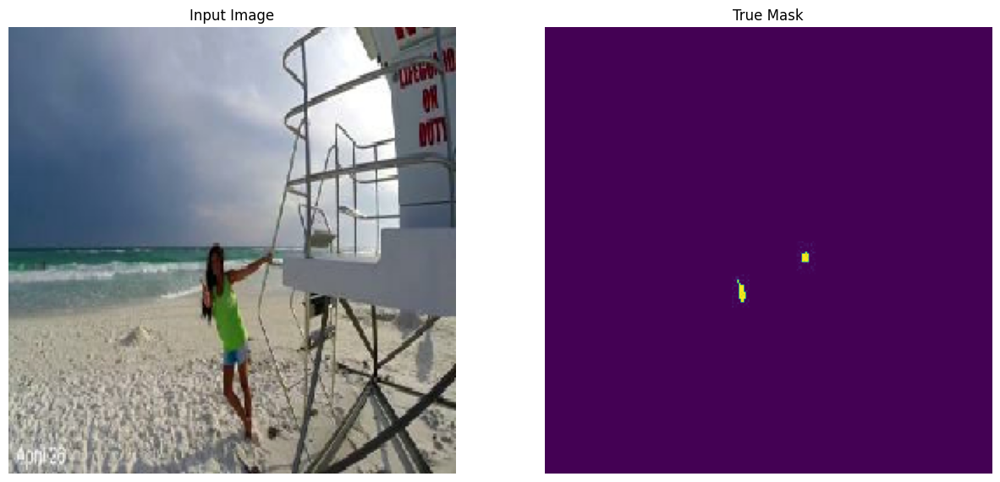

In [20]:
#We will use this sample image during the training procedure
for image, mask in val_dataset.take(1):
    sample_image, sample_mask = image,mask
display([sample_image,sample_mask])


In [ ]:
# We define a UNet architecture with MobileNetV2 as the backbone and with all layers trainable
# Our decoder has dropout and batchnorm for regularization

def create_unet(input_shape=(256, 256, 3), num_classes=1, dropout_rate=0.2):
    # Load pre-trained MobileNetV2 model as the encoder
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)

    # Encoder pathway
    encoder = base_model.get_layer('block_12_expand').output

    # Decoder pathway
    decoder = Conv2DTranspose(96, (2, 2), strides=(2, 2), padding='same')(encoder)
    decoder = BatchNormalization()(decoder)
    decoder = Conv2D(96, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Conv2D(96, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Dropout(dropout_rate)(decoder)
    decoder = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = Conv2D(64, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Conv2D(64, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Dropout(dropout_rate)(decoder)
    decoder = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = Conv2D(32, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Conv2D(32, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Dropout(dropout_rate)(decoder)
    decoder = Conv2DTranspose(24, (2, 2), strides=(2, 2), padding='same')(decoder)
    decoder = BatchNormalization()(decoder)
    decoder = Conv2D(24, (3, 3), activation='relu', padding='same')(decoder)
    decoder = Conv2D(24, (3, 3), activation='relu', padding='same')(decoder)

    # Output segmentation map
    output = Conv2D(num_classes, (1, 1), activation='sigmoid')(decoder)

    # Create the U-Net model
    model = Model(inputs=base_model.input, outputs=output)

    return model

# Create the U-Net model
model = create_unet()

# Print the model summary
model.summary()


9406464/9406464 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 128, 128, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 128, 128, 32  128         ['Conv1[0][0]']                  
                               

In [22]:
#defining dice coefficient
def dice_coeff(y_true, y_pred):
    smooth = 1.
    # Flatten
    y_true_f = tf.reshape(y_true, [-1])
    y_pred_f = tf.reshape(y_pred, [-1])

    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    score = ((2. * intersection) + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)
    return score


#calculation of diceloss
def dice_loss(y_true, y_pred):
    loss = 1 - dice_coeff(y_true, y_pred)
    return loss

#defining our custom loss using binary cross entropy and dice loss
def bce_dice_loss(y_true, y_pred):
    loss = tf.keras.losses.binary_crossentropy(y_true, y_pred) + dice_loss(y_true, y_pred)
    return loss

In [23]:
# We use Adam as our optimizer and binary cros entropy + dice loss as our loss function
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001,beta_1=0.9,beta_2=0.999,epsilon=10e-8), loss=bce_dice_loss, metrics=['accuracy', dice_loss,dice_coeff])

In [24]:
def create_mask(pred_mask):
  new_mask = pred_mask[0]

  for i in range(new_mask.shape[0]):
    for j in range(new_mask.shape[1]):
      if new_mask[i,j] >= 0.5:
        new_mask[i,j] = 1
      else:
        new_mask[i,j] = 0

  return new_mask


def show_predictions(model,dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask, create_mask(model.predict(sample_image[tf.newaxis, ...]))])

In [25]:
#defining callbacks 
target_dir = './snapshots'

if not os.path.exists(target_dir):
  os.mkdir(target_dir)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                   factor=0.2,
                                   patience=3,
                                   verbose=2,
                                   min_delta=1e-3,min_lr = 1e-10
                                   )
file_path = 'snapshots/best_weight{epoch:03d}.h5'
checkpoints = tf.keras.callbacks.ModelCheckpoint(file_path, monitor = 'val_loss', verbose = 0, save_best_only = True)

In [26]:
# Defining training step 
EPOCHS = 50
BUFFER_SIZE = 1000
BATCH_SIZE = 8
train = train_dataset.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train = train.prefetch(buffer_size=tf.data.AUTOTUNE)
val = val_dataset.batch(BATCH_SIZE)

model_history = model.fit(train,
                         epochs=EPOCHS,
                         steps_per_epoch=int(np.ceil(len(X_train)/BATCH_SIZE)),
                         validation_data=val,
                         validation_steps=int(np.ceil(len(X_val)/BATCH_SIZE)),
                         verbose=1,
                         callbacks=[reduce_lr,checkpoints])


Epoch 1/50
646/646 [==============================] - 104s 83ms/step - loss: 0.6508 - accuracy: 0.9444 - dice_loss: 0.5015 - dice_coeff: 0.4985 - val_loss: 1.2409 - val_accuracy: 0.8577 - val_dice_loss: 0.9060 - val_dice_coeff: 0.0940 - lr: 0.0010
Epoch 2/50
646/646 [==============================] - 33s 52ms/step - loss: 0.4245 - accuracy: 0.9585 - dice_loss: 0.3198 - dice_coeff: 0.6802 - val_loss: 1.6739 - val_accuracy: 0.9412 - val_dice_loss: 0.9999 - val_dice_coeff: 7.0055e-05 - lr: 0.0010
Epoch 3/50
646/646 [==============================] - 33s 52ms/step - loss: 0.3430 - accuracy: 0.9635 - dice_loss: 0.2573 - dice_coeff: 0.7427 - val_loss: 1.5703 - val_accuracy: 0.9412 - val_dice_loss: 0.9998 - val_dice_coeff: 1.9464e-04 - lr: 0.0010
Epoch 4/50
645/646 [============================>.] - ETA: 0s - loss: 0.3046 - accuracy: 0.9658 - dice_loss: 0.2286 - dice_coeff: 0.7714
Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00020000000949949026.
646/646 [===========================

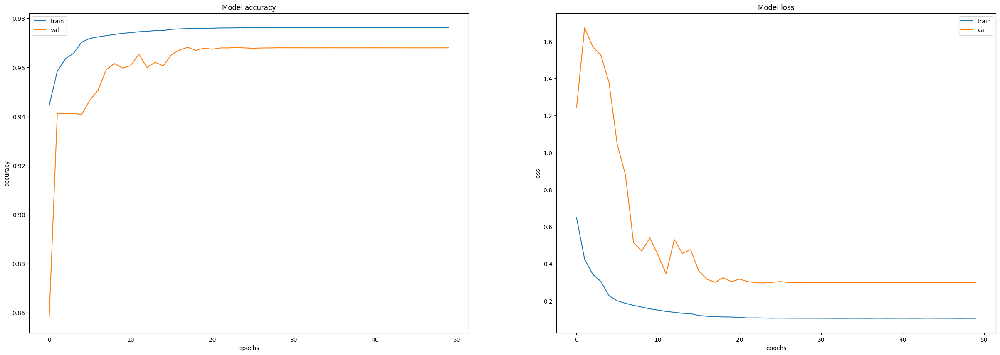

In [27]:
#plotting losses

fig, ax = plt.subplots(1, 2, figsize=(30, 10))
ax = ax.ravel()

for i, metric in enumerate(["accuracy", "loss"]):
    ax[i].plot(model.history.history[metric][:])
    ax[i].plot(model.history.history["val_" + metric][:])
    ax[i].set_title("Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])

In [ ]:
# loading the weights from best epoch 
from  tensorflow.keras.models import load_model

model = load_model('./snapshots/best_weight026.h5',custom_objects={'bce_dice_loss':bce_dice_loss,'dice_loss':dice_loss,'dice_coeff':dice_coeff})

1/1 [==============================] - 1s 772ms/step


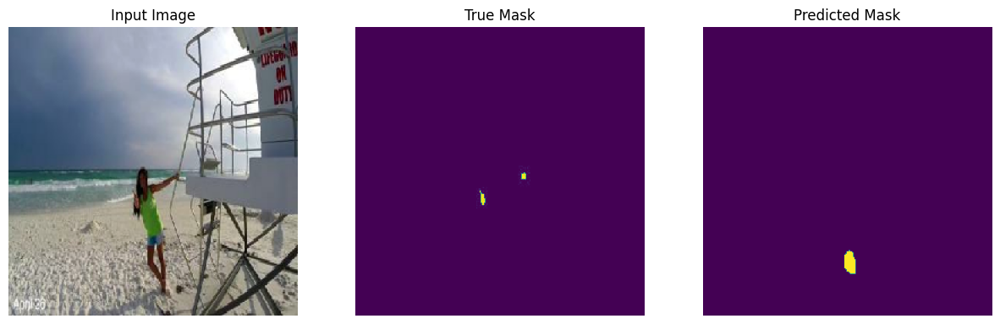

1/1 [==============================] - 0s 32ms/step


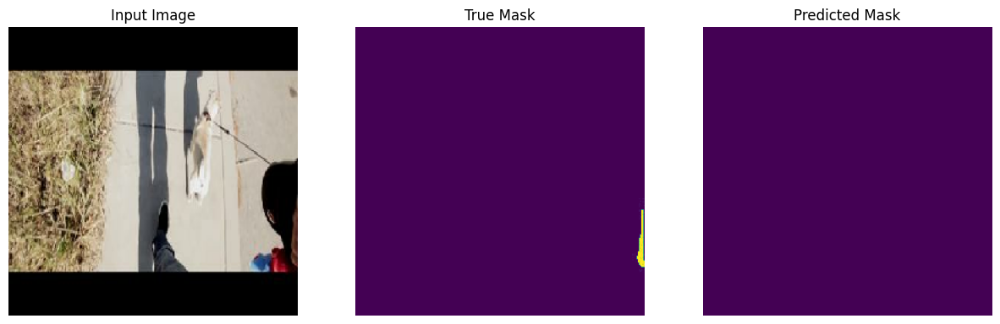

1/1 [==============================] - 0s 56ms/step


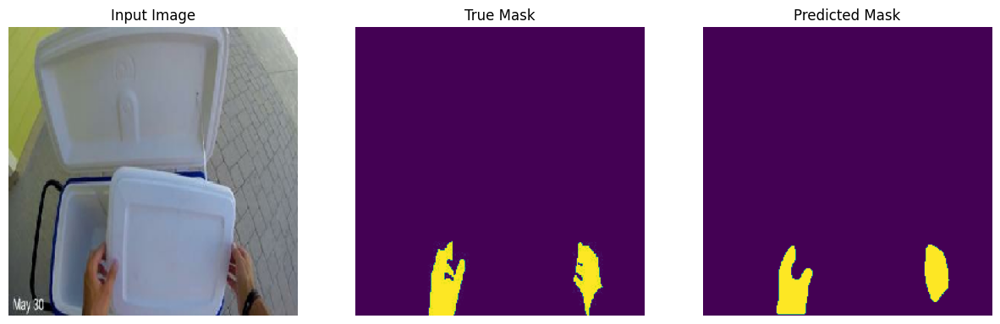

1/1 [==============================] - 0s 42ms/step


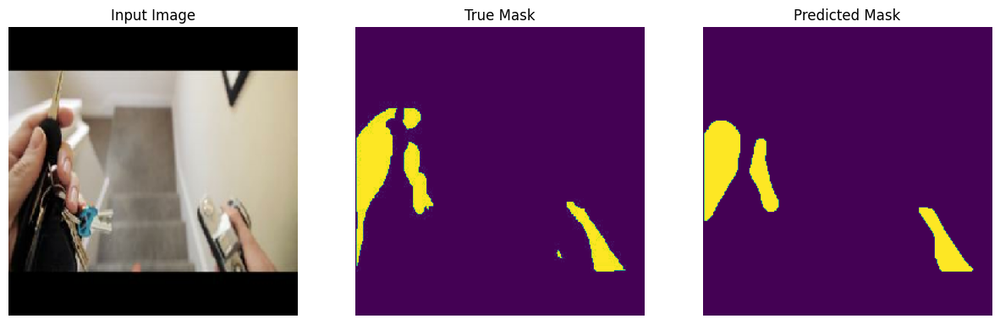

1/1 [==============================] - 0s 38ms/step


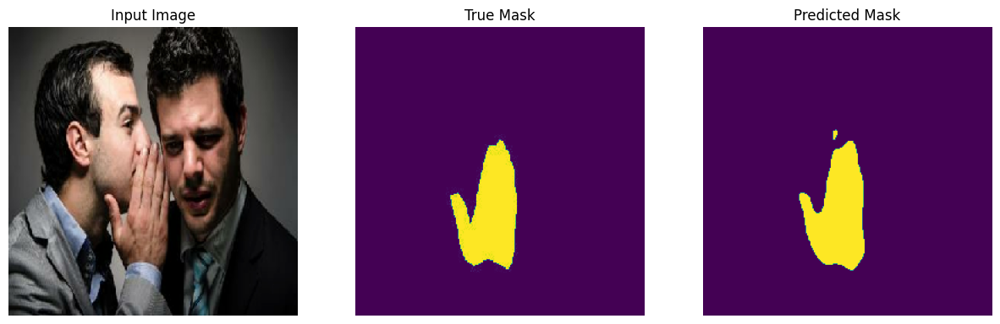

1/1 [==============================] - 0s 48ms/step


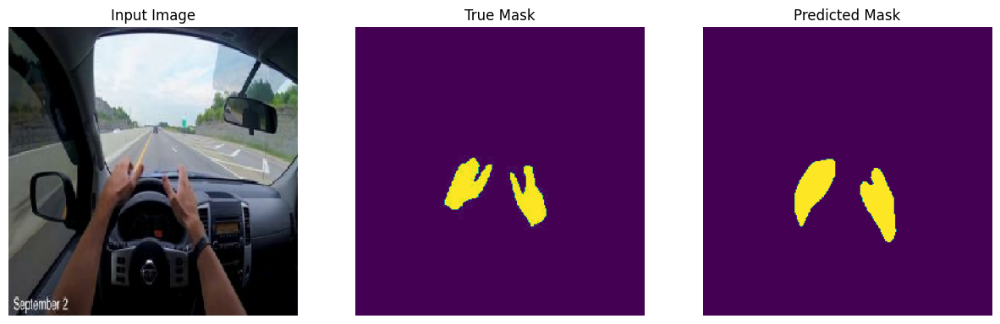

1/1 [==============================] - 0s 42ms/step


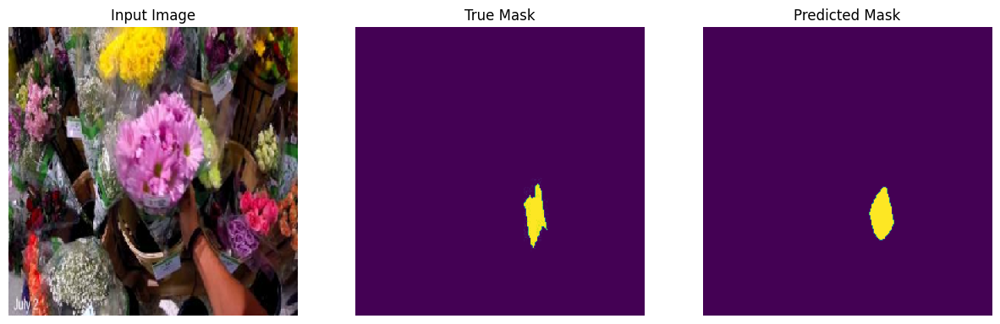

1/1 [==============================] - 0s 54ms/step


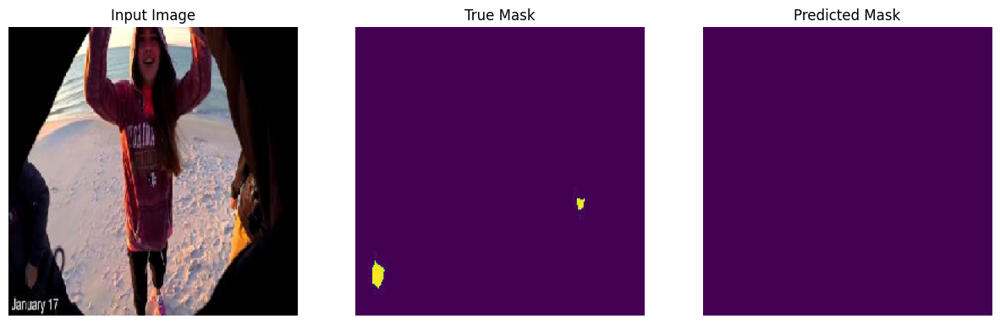

1/1 [==============================] - 0s 30ms/step


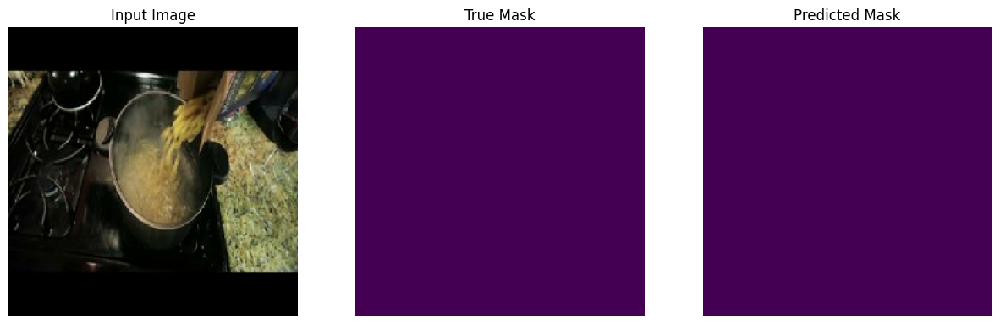

1/1 [==============================] - 0s 33ms/step


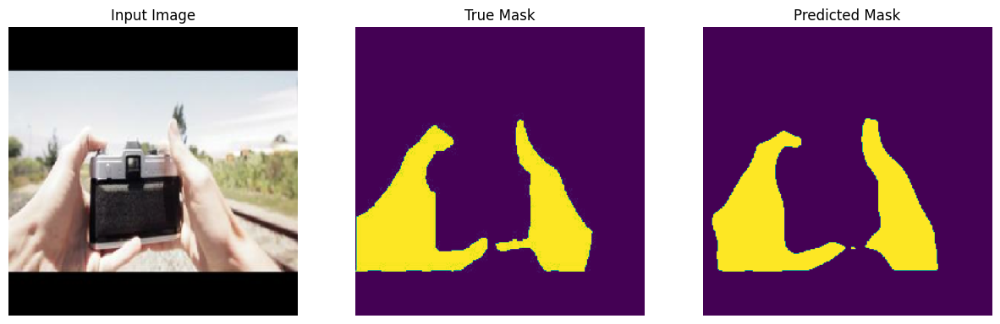

1/1 [==============================] - 0s 31ms/step


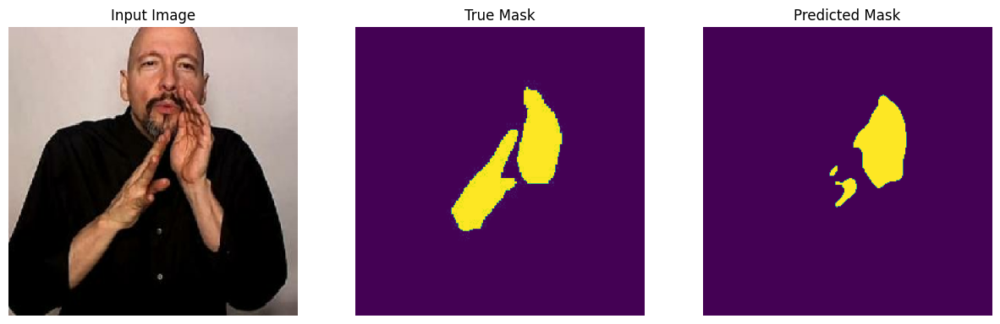

1/1 [==============================] - 0s 26ms/step


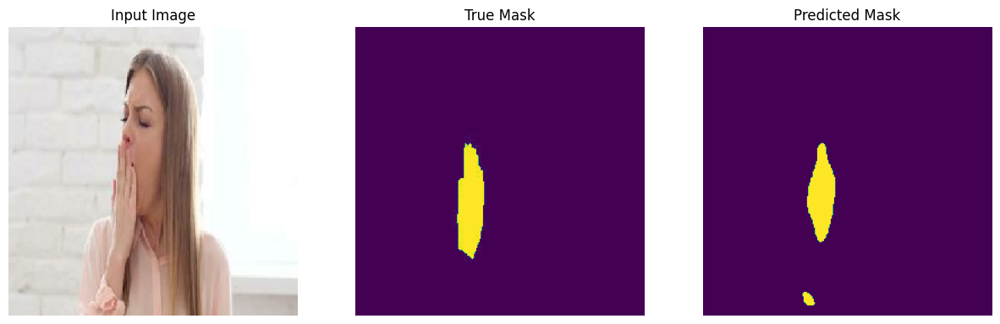

1/1 [==============================] - 0s 30ms/step


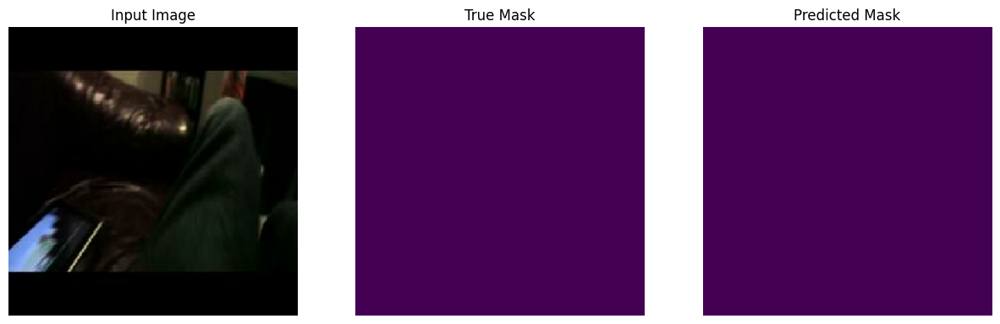

1/1 [==============================] - 0s 63ms/step


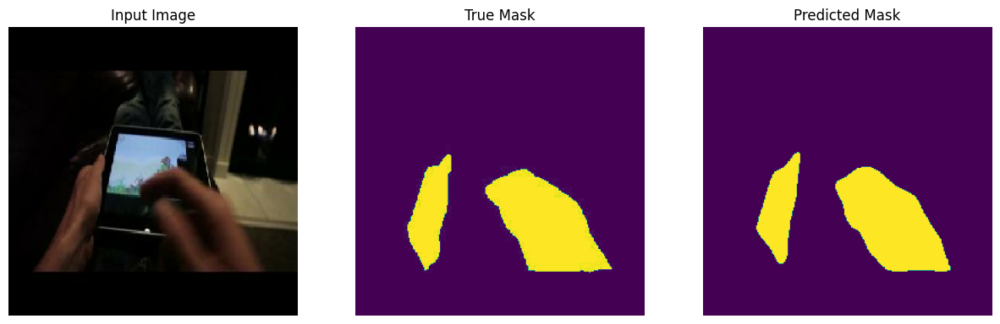

1/1 [==============================] - 0s 29ms/step


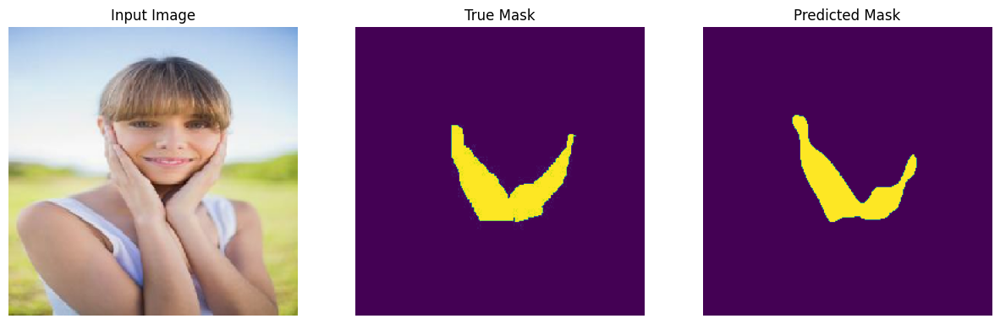

1/1 [==============================] - 0s 36ms/step


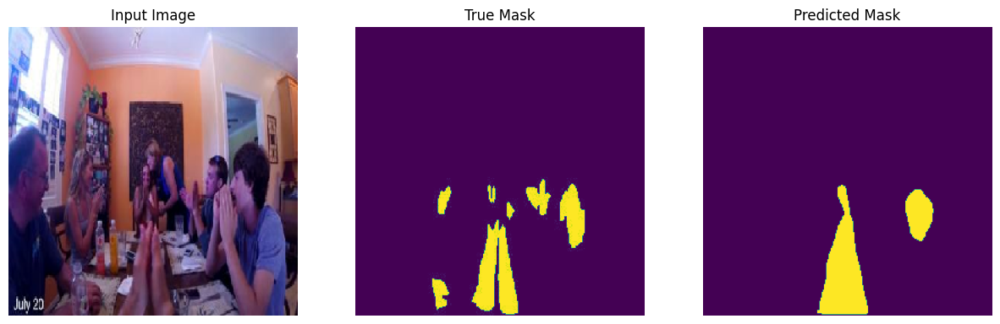

1/1 [==============================] - 0s 56ms/step


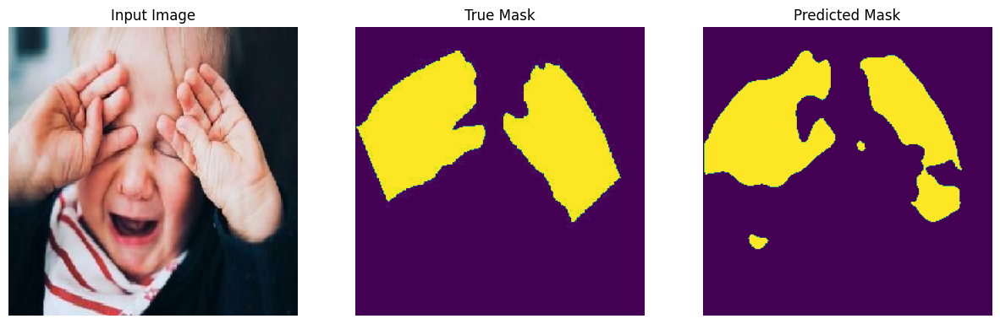

1/1 [==============================] - 0s 40ms/step


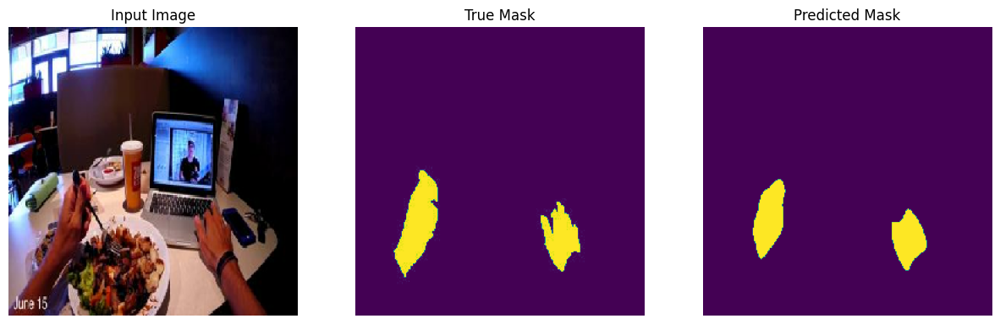

In [28]:
#inference on val set
show_predictions(model,val, 20)

In [29]:
#saving model
model.save('/content/drive/MyDrive/hand_seg_base/weights_aug_bb_best.h5')

1/1 [==============================] - 1s 868ms/step


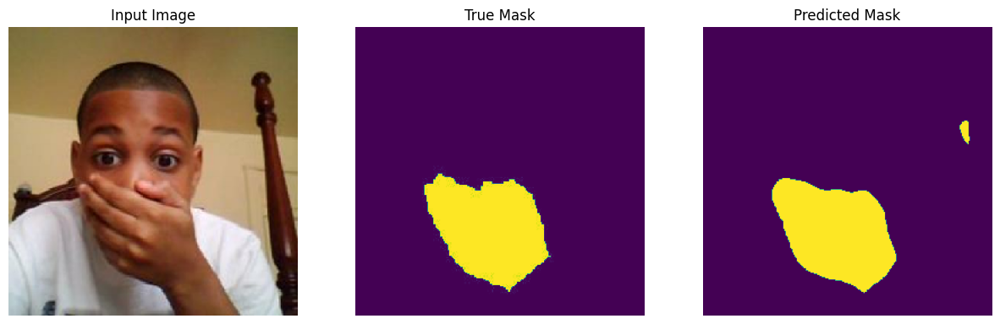

1/1 [==============================] - 0s 32ms/step


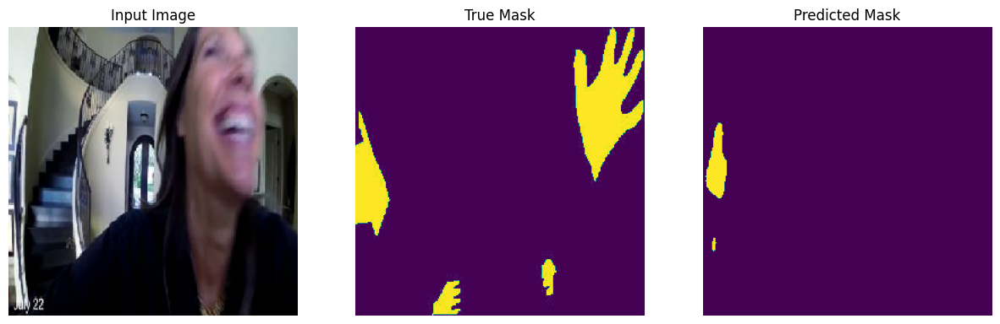

1/1 [==============================] - 0s 26ms/step


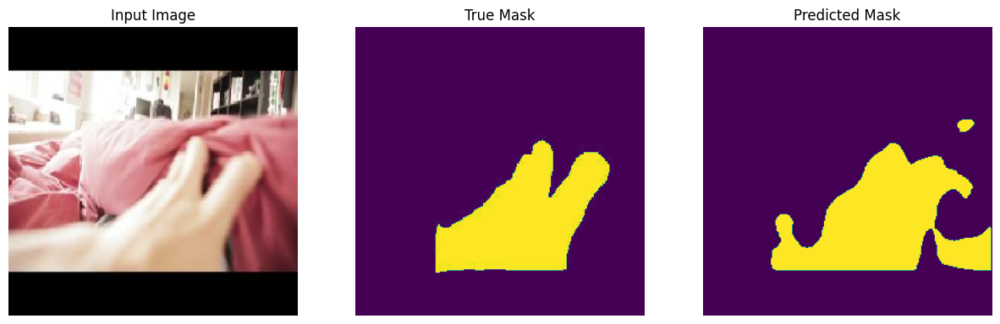

1/1 [==============================] - 0s 33ms/step


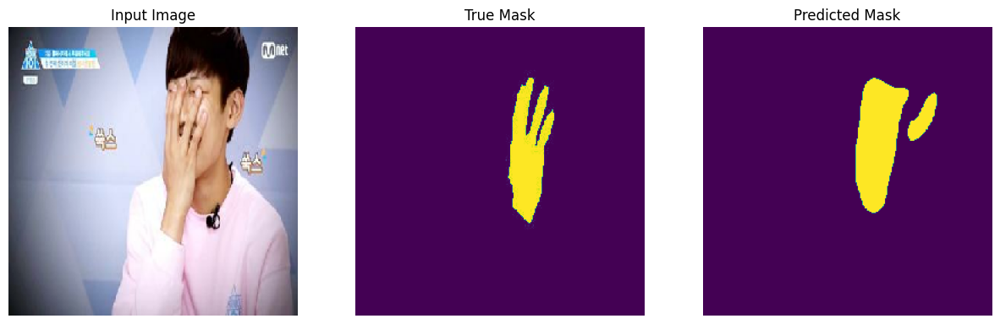

1/1 [==============================] - 0s 27ms/step


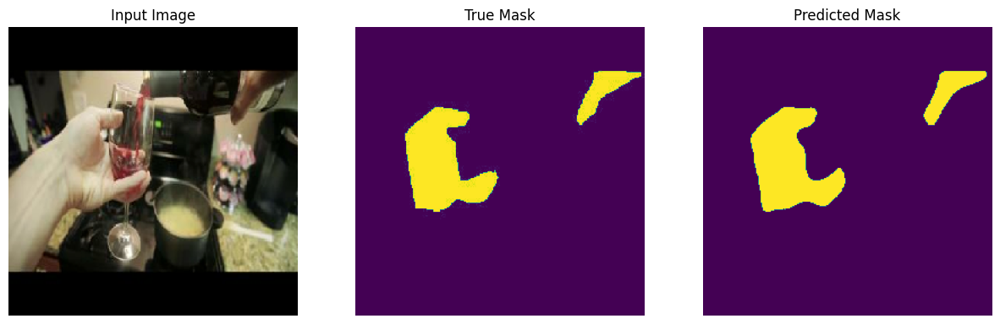

1/1 [==============================] - 0s 26ms/step


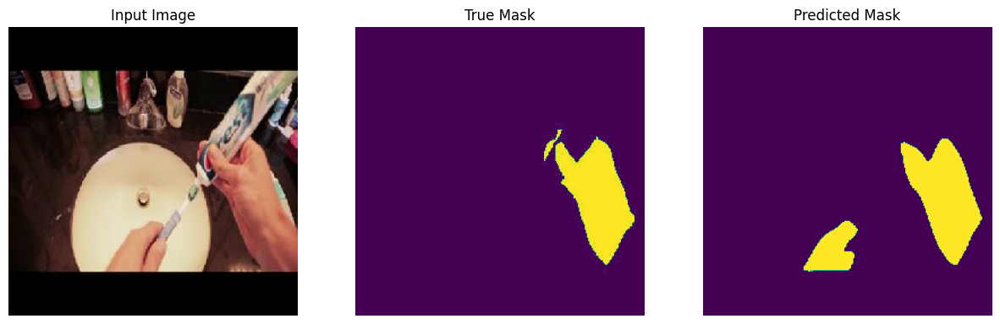

1/1 [==============================] - 0s 23ms/step


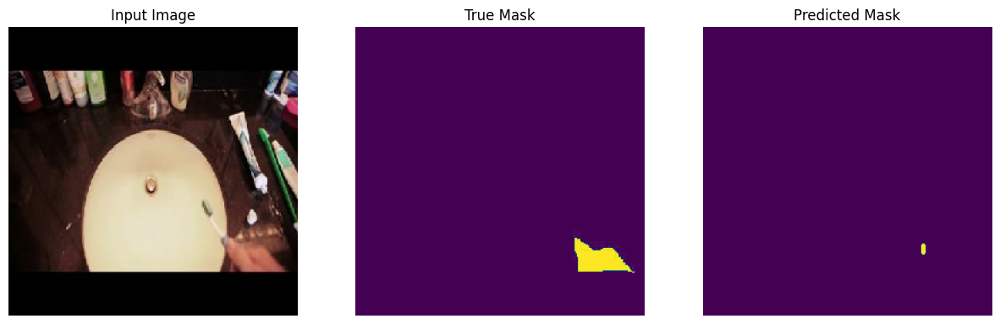

1/1 [==============================] - 0s 39ms/step


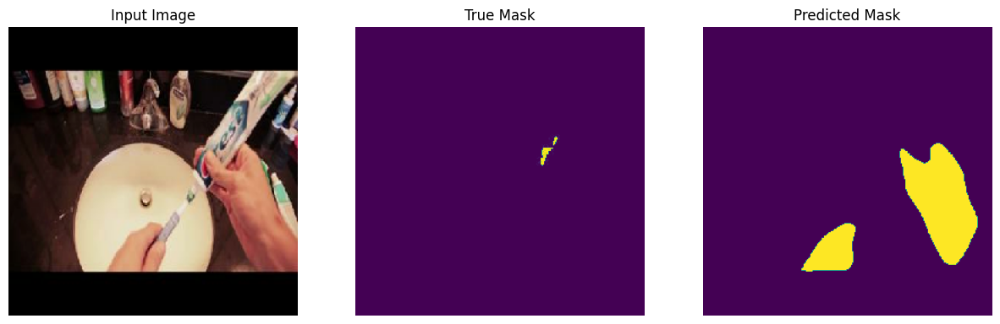

1/1 [==============================] - 0s 45ms/step


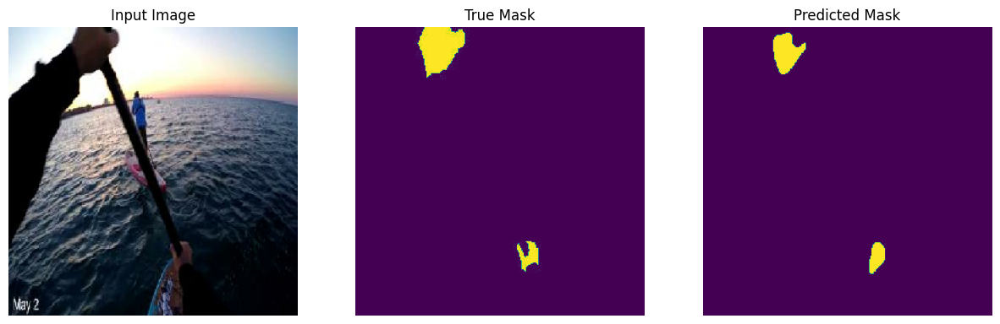

1/1 [==============================] - 0s 40ms/step


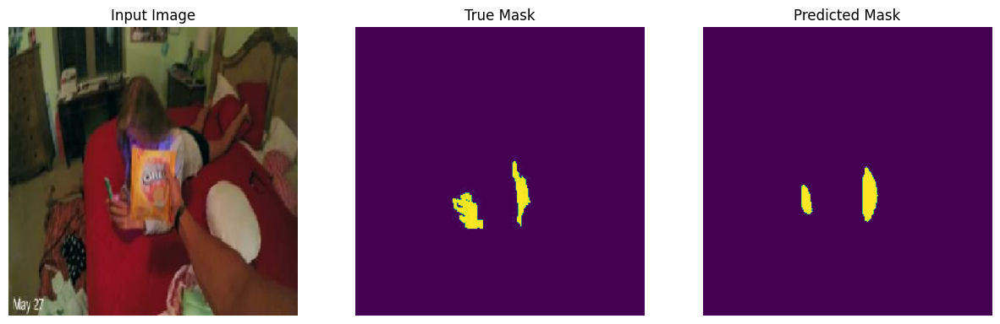

1/1 [==============================] - 0s 53ms/step


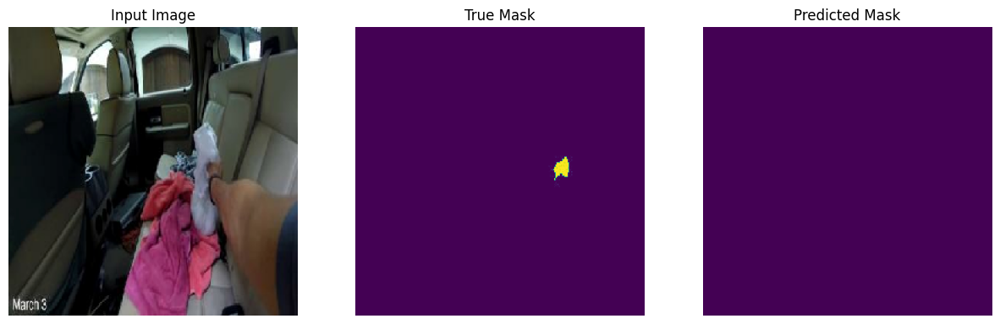

1/1 [==============================] - 0s 27ms/step


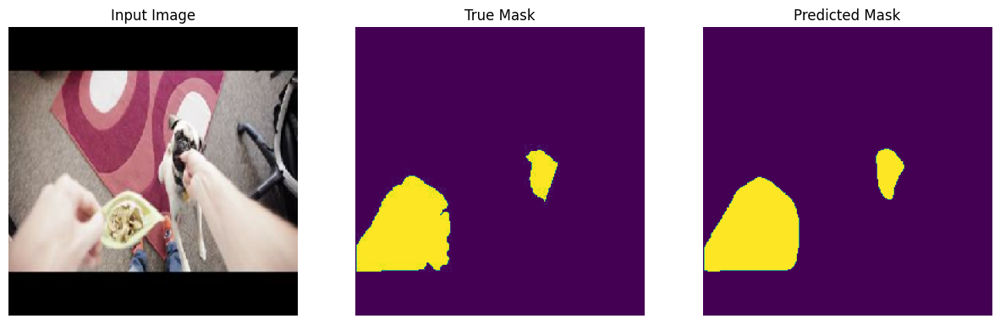

1/1 [==============================] - 0s 28ms/step


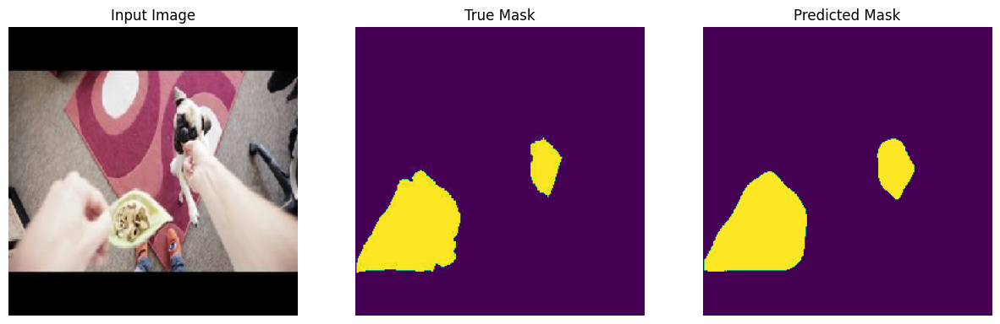

1/1 [==============================] - 0s 27ms/step


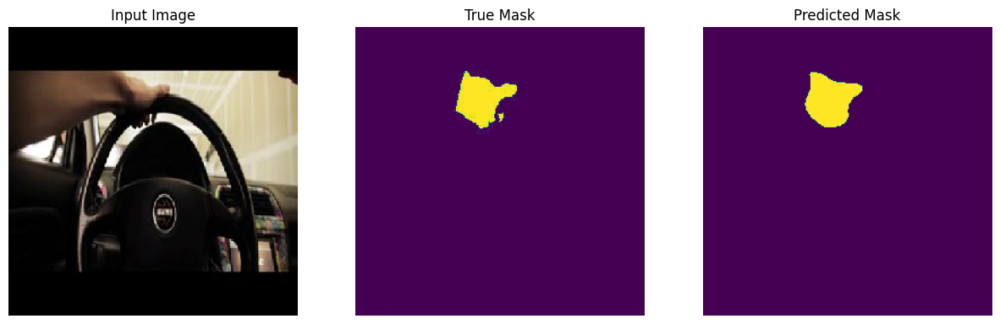

1/1 [==============================] - 0s 28ms/step


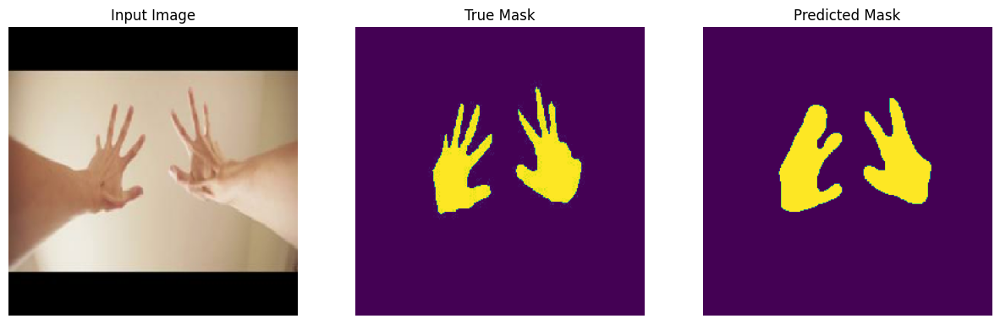

1/1 [==============================] - 0s 26ms/step


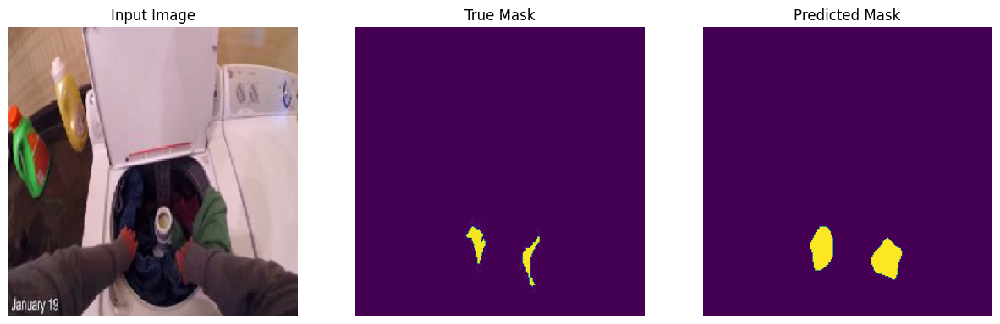

1/1 [==============================] - 0s 29ms/step


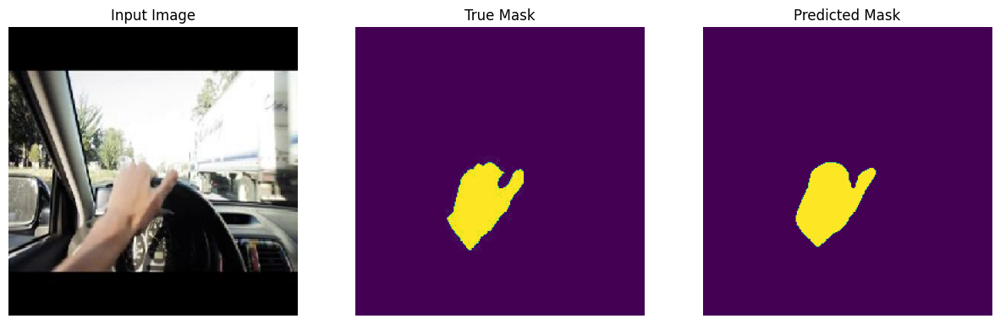

1/1 [==============================] - 0s 27ms/step


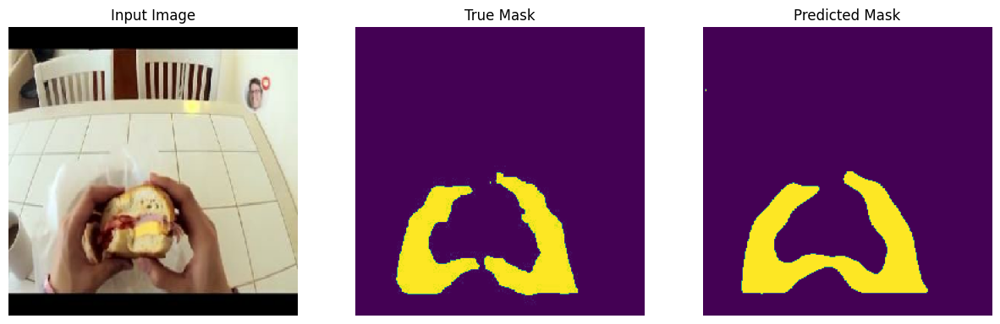

1/1 [==============================] - 0s 39ms/step


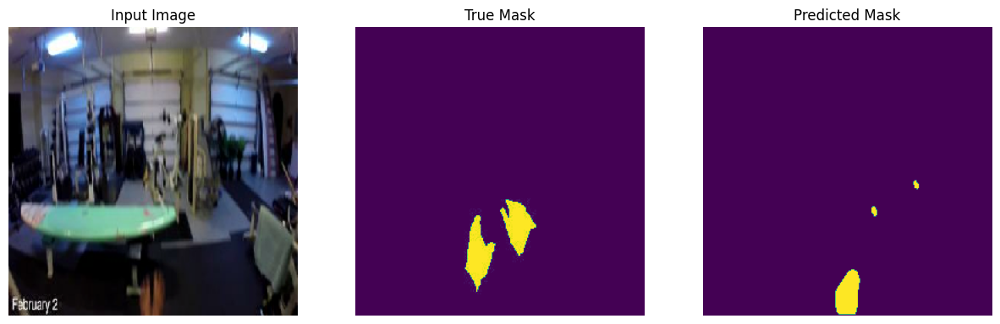

1/1 [==============================] - 0s 35ms/step


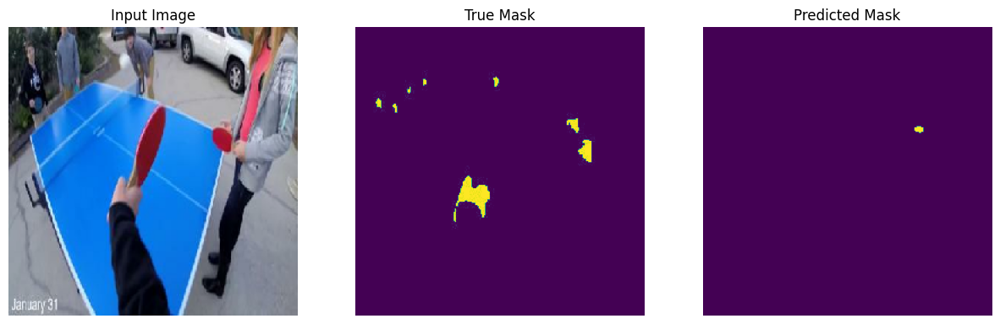

1/1 [==============================] - 0s 43ms/step


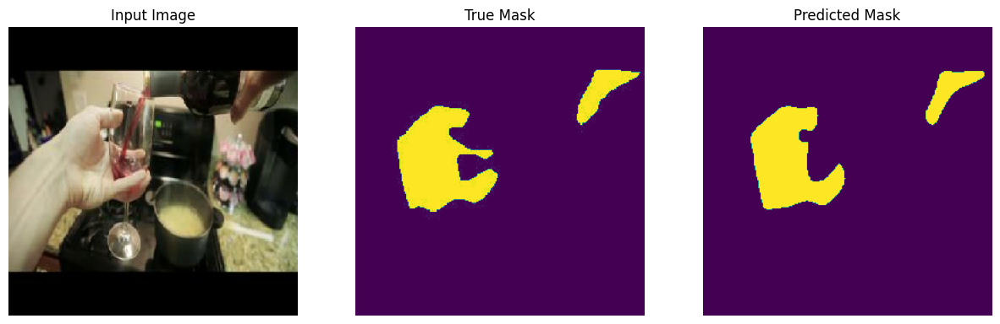

1/1 [==============================] - 0s 34ms/step


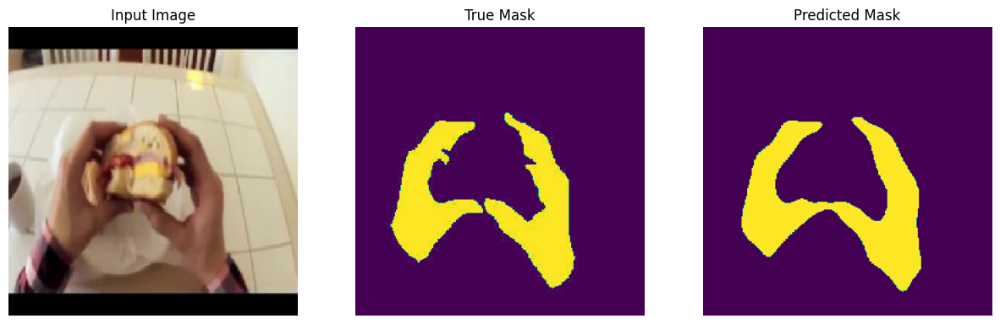

1/1 [==============================] - 0s 35ms/step


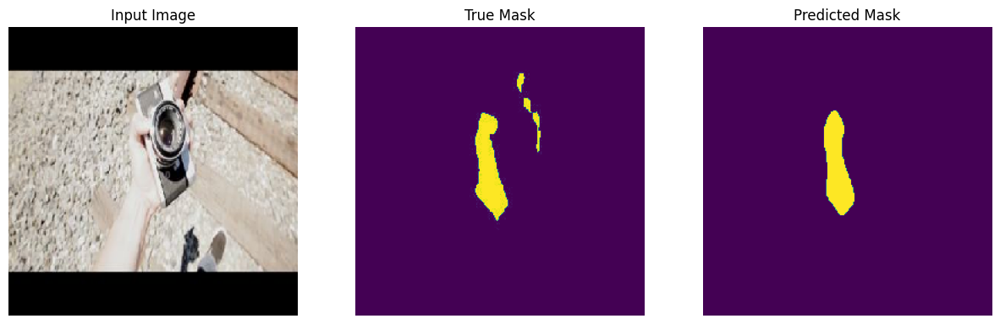

1/1 [==============================] - 0s 35ms/step


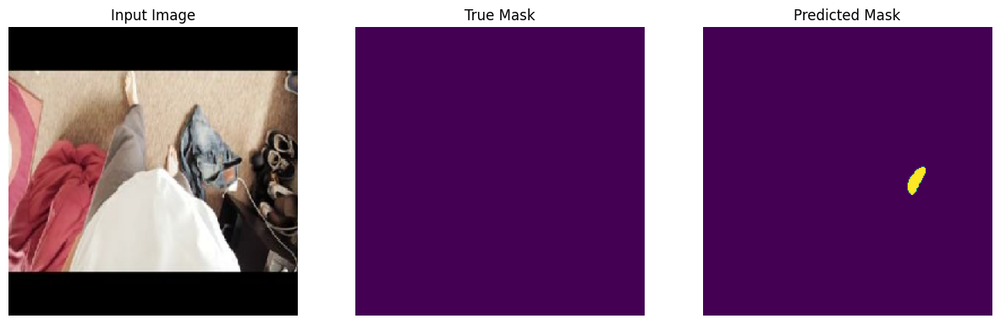

1/1 [==============================] - 0s 32ms/step


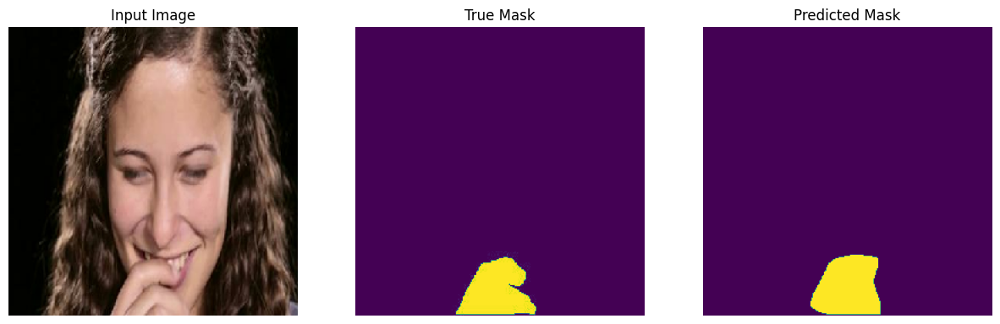

1/1 [==============================] - 0s 44ms/step


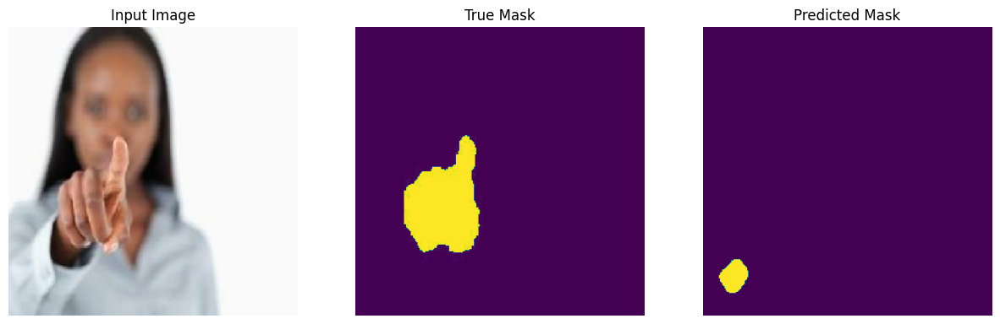

1/1 [==============================] - 0s 37ms/step


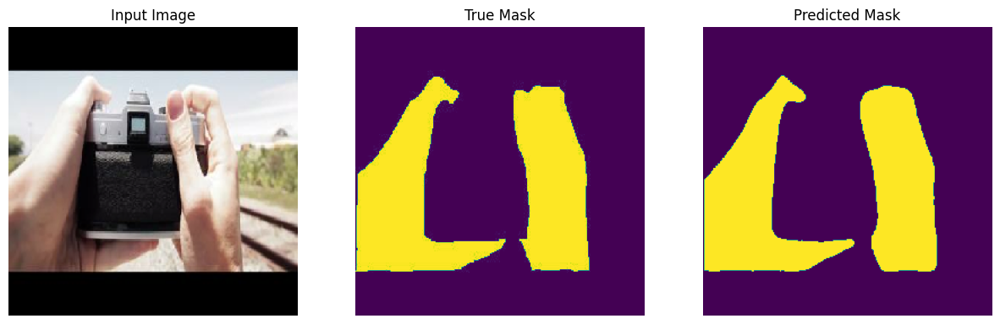

1/1 [==============================] - 0s 50ms/step


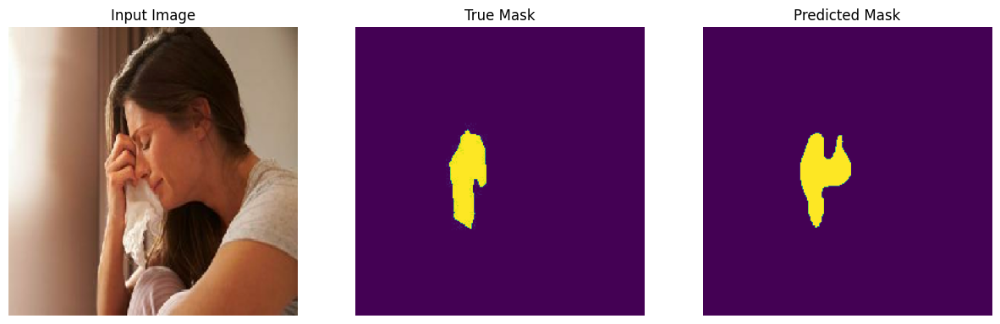

1/1 [==============================] - 0s 56ms/step


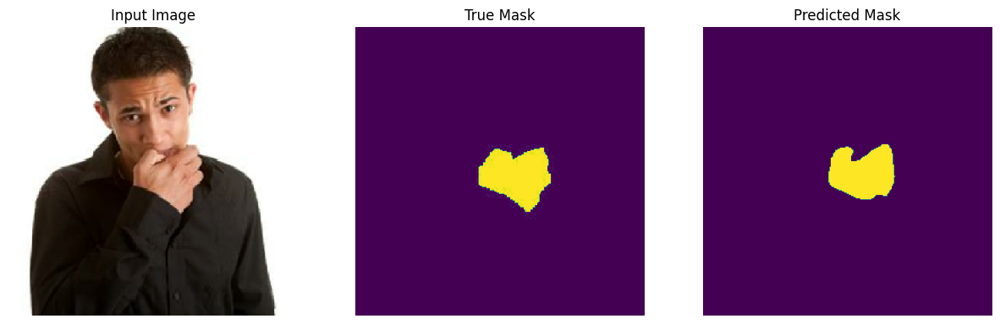

1/1 [==============================] - 0s 43ms/step


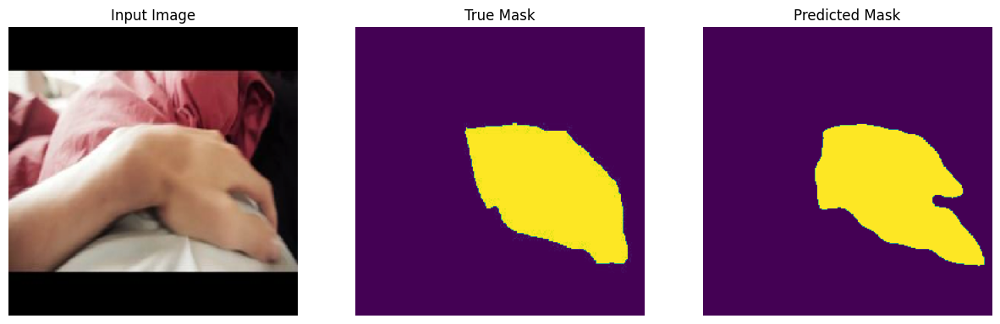

1/1 [==============================] - 0s 43ms/step


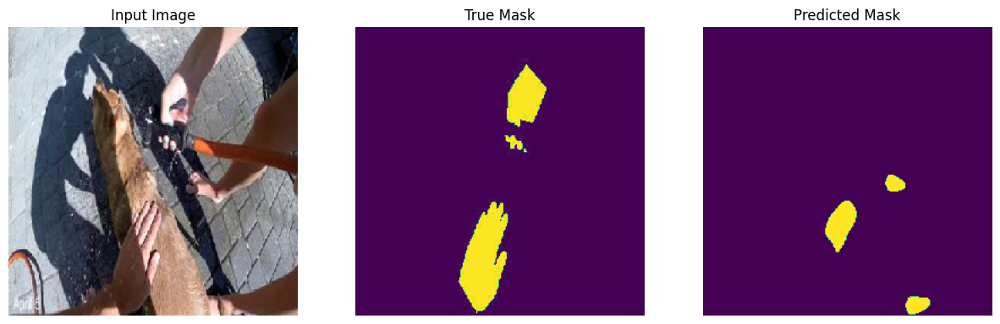

1/1 [==============================] - 0s 65ms/step


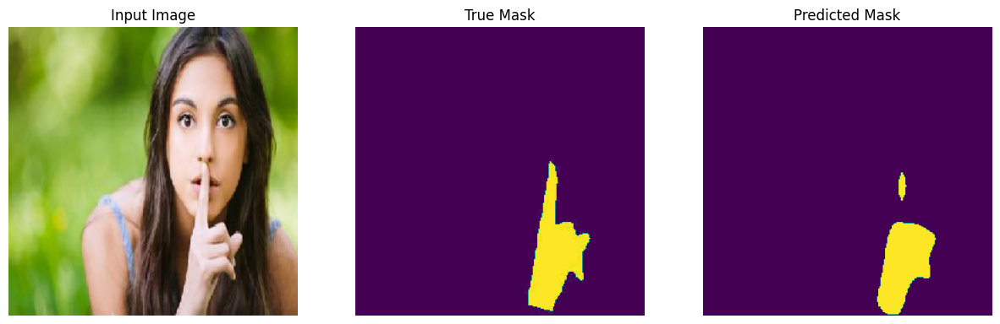

1/1 [==============================] - 0s 36ms/step


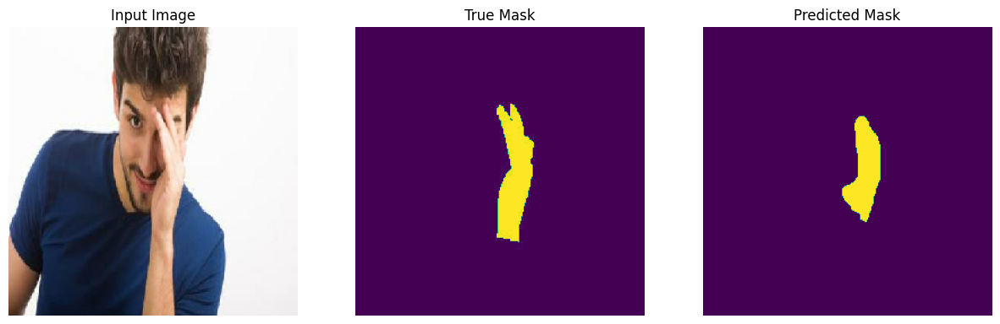

1/1 [==============================] - 0s 43ms/step


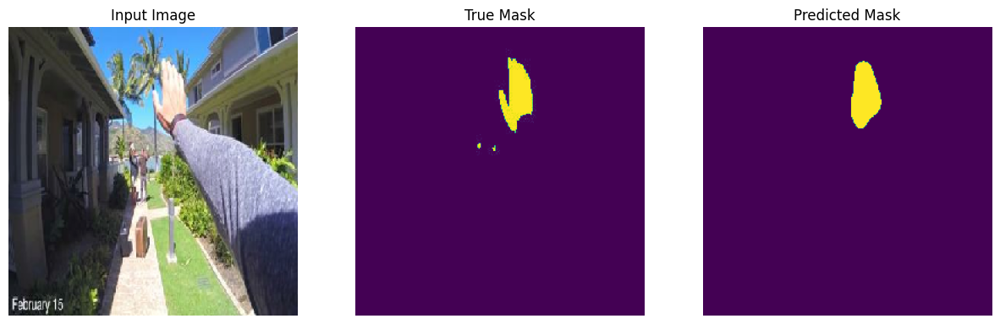

1/1 [==============================] - 0s 41ms/step


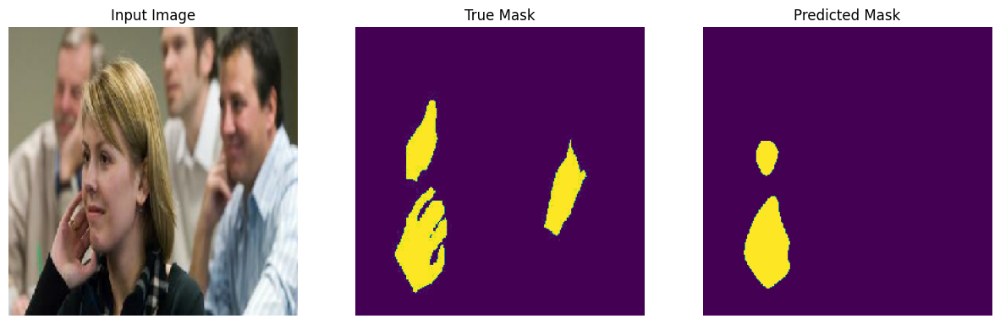

1/1 [==============================] - 0s 45ms/step


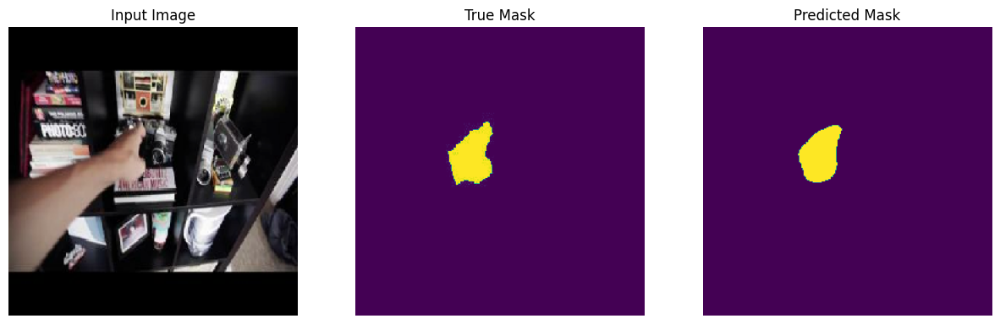

1/1 [==============================] - 0s 45ms/step


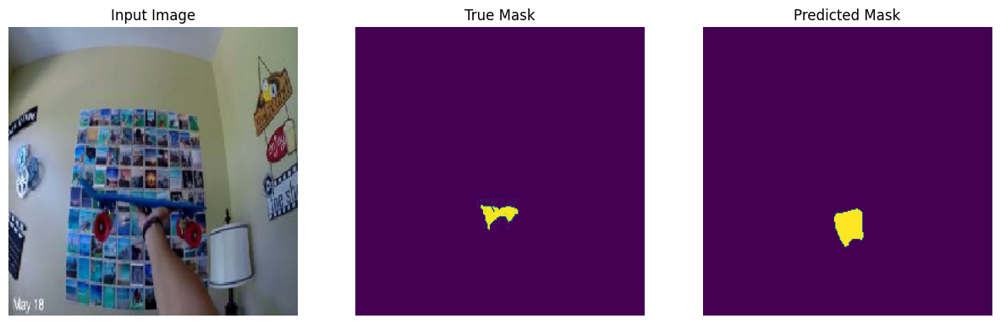

1/1 [==============================] - 0s 35ms/step


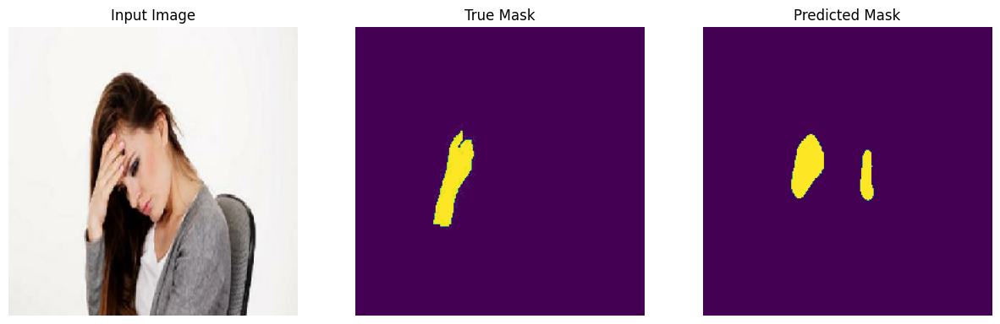

1/1 [==============================] - 0s 40ms/step


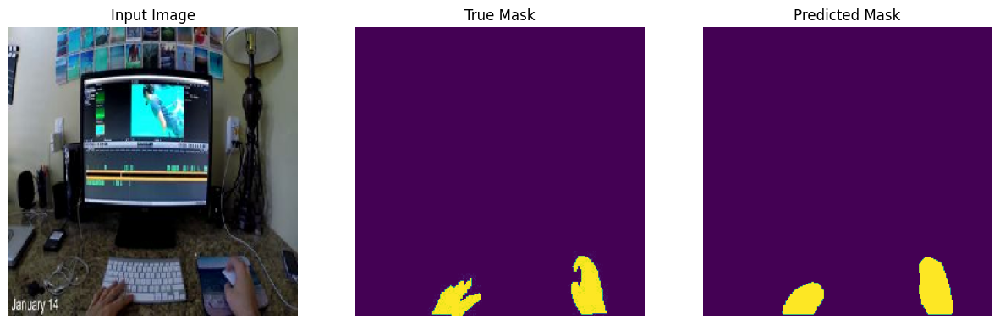

1/1 [==============================] - 0s 53ms/step


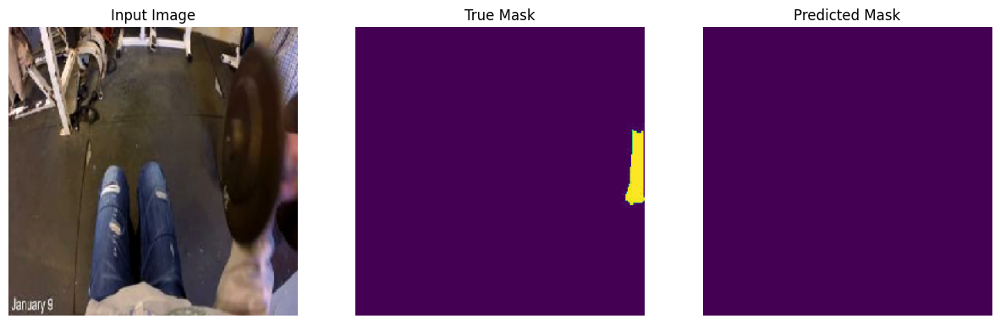

1/1 [==============================] - 0s 33ms/step


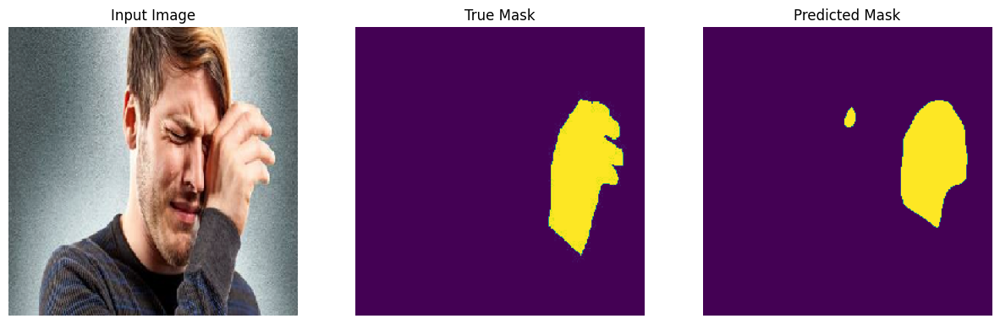

1/1 [==============================] - 0s 40ms/step


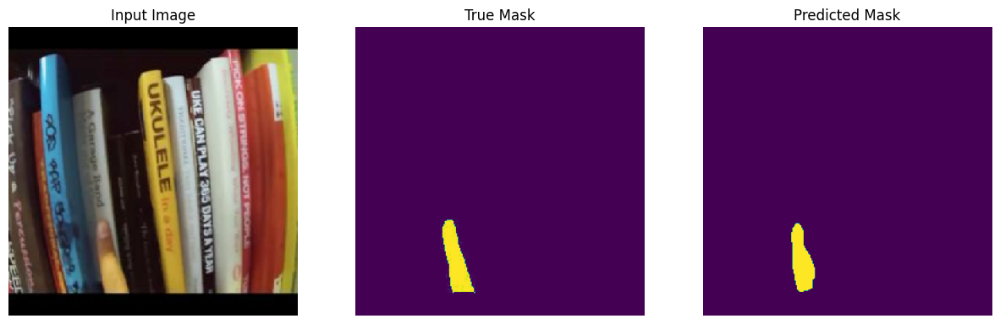

1/1 [==============================] - 0s 34ms/step


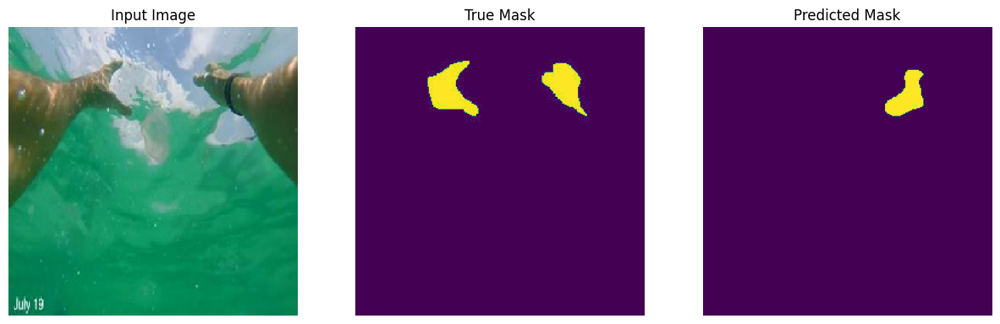

1/1 [==============================] - 0s 34ms/step


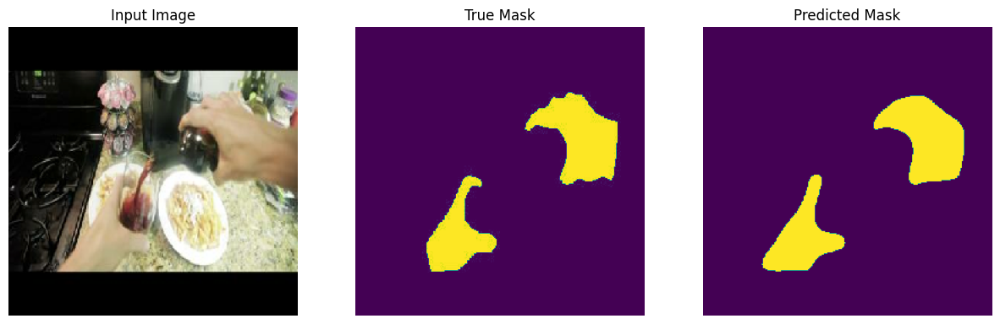

1/1 [==============================] - 0s 41ms/step


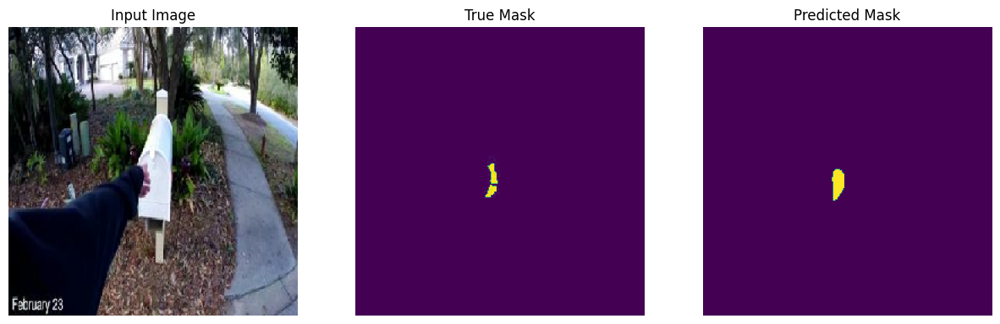

1/1 [==============================] - 0s 40ms/step


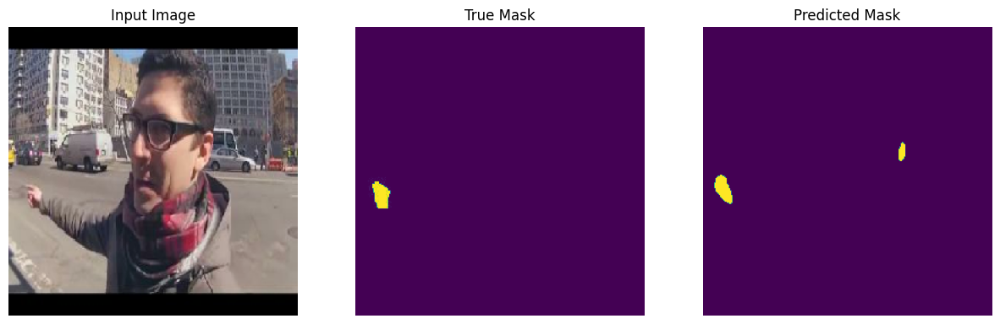

1/1 [==============================] - 0s 70ms/step


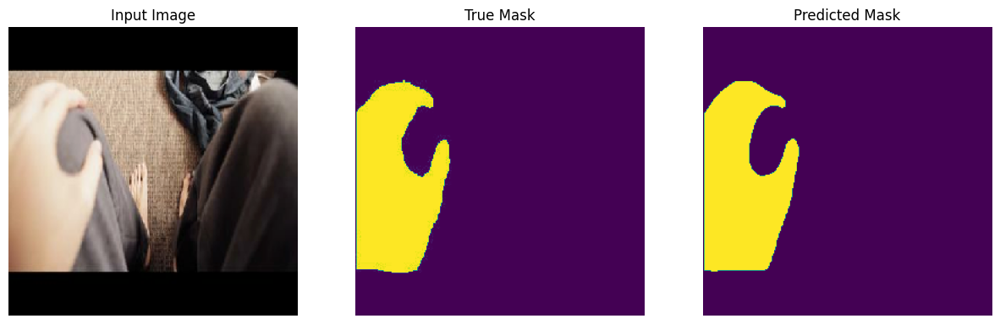

1/1 [==============================] - 0s 36ms/step


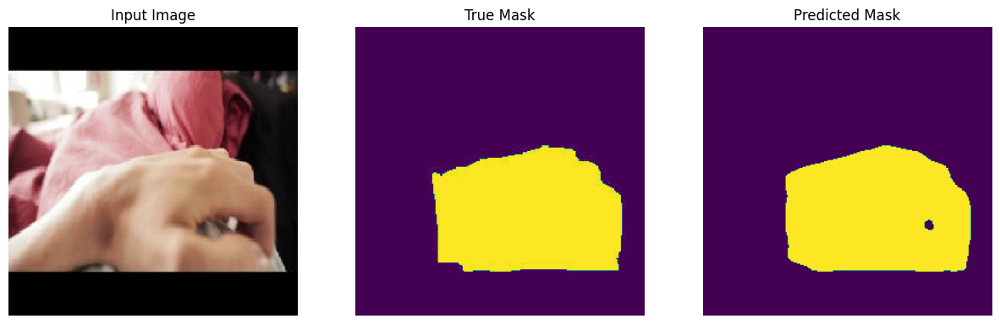

1/1 [==============================] - 0s 42ms/step


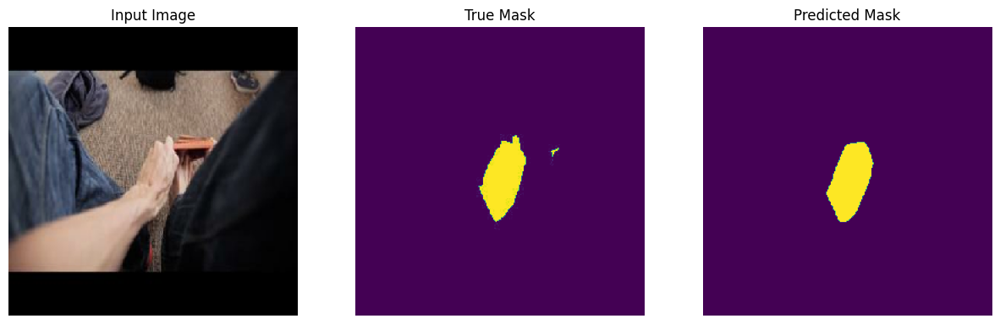

1/1 [==============================] - 0s 55ms/step


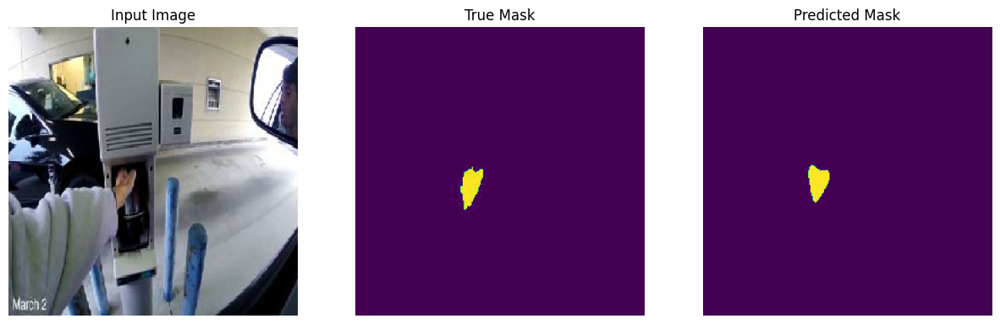

1/1 [==============================] - 0s 46ms/step


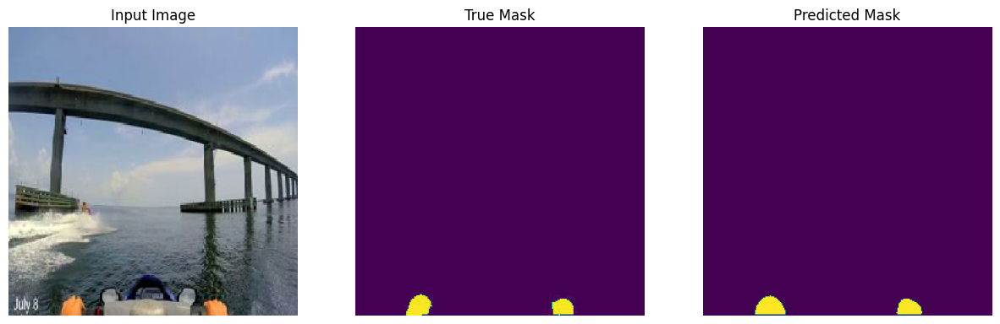

1/1 [==============================] - 0s 73ms/step


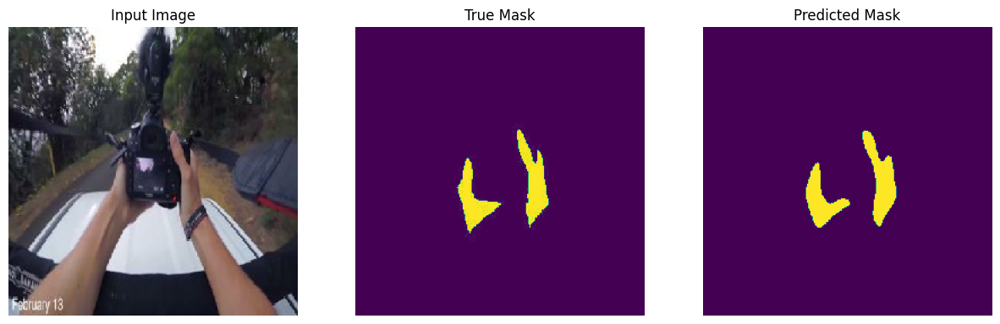

1/1 [==============================] - 0s 45ms/step


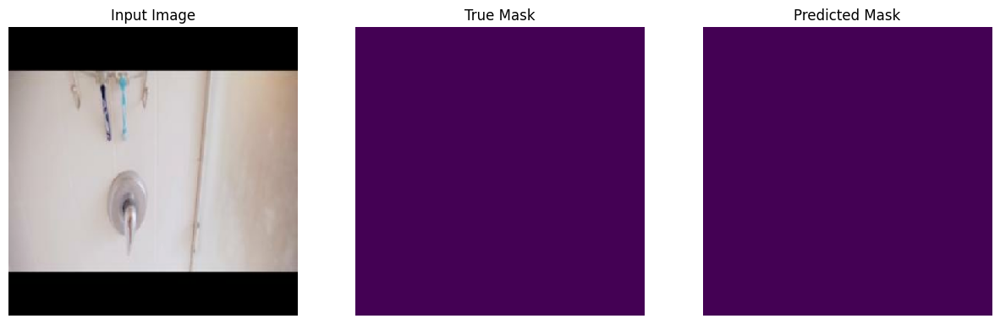

1/1 [==============================] - 0s 36ms/step


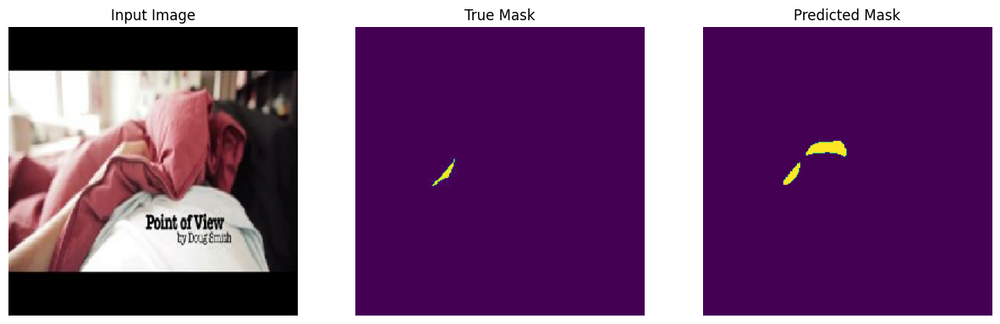

1/1 [==============================] - 0s 35ms/step


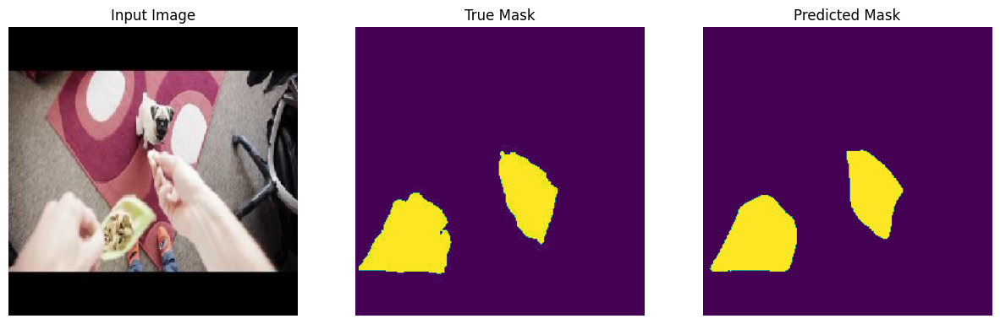

1/1 [==============================] - 0s 38ms/step


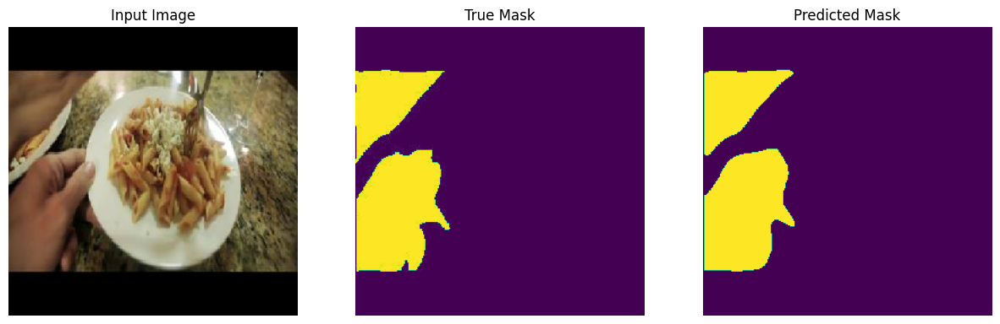

1/1 [==============================] - 0s 38ms/step


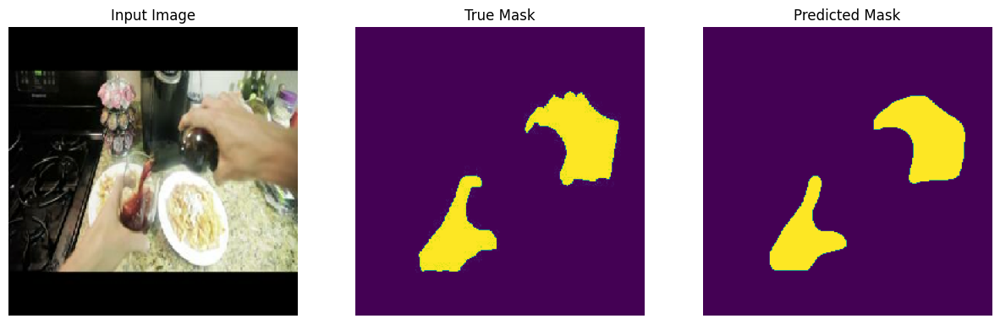

1/1 [==============================] - 0s 45ms/step


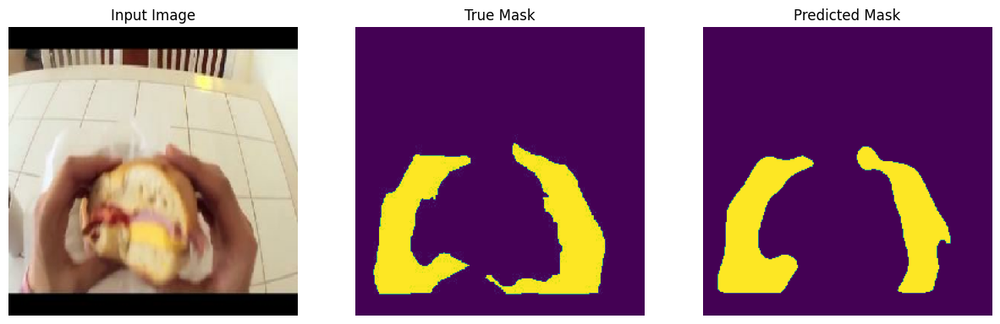

1/1 [==============================] - 0s 47ms/step


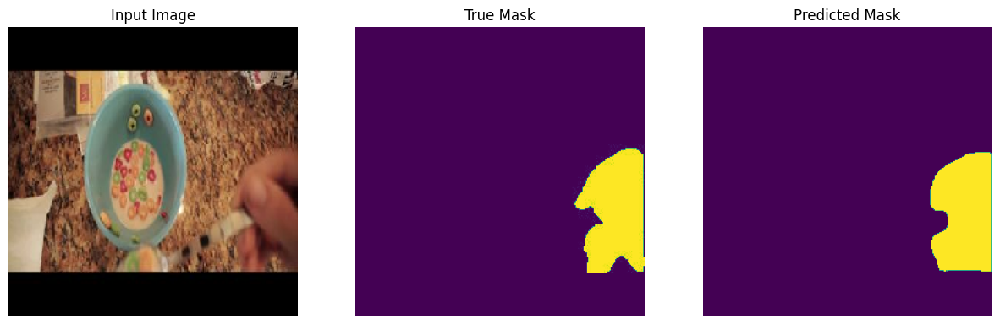

1/1 [==============================] - 0s 44ms/step


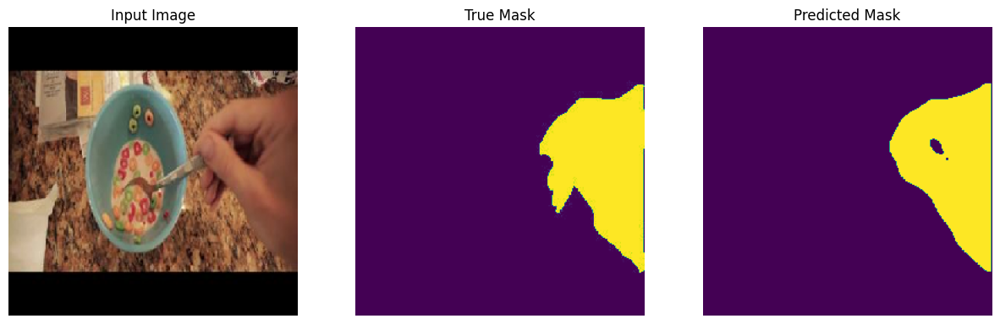

1/1 [==============================] - 0s 51ms/step


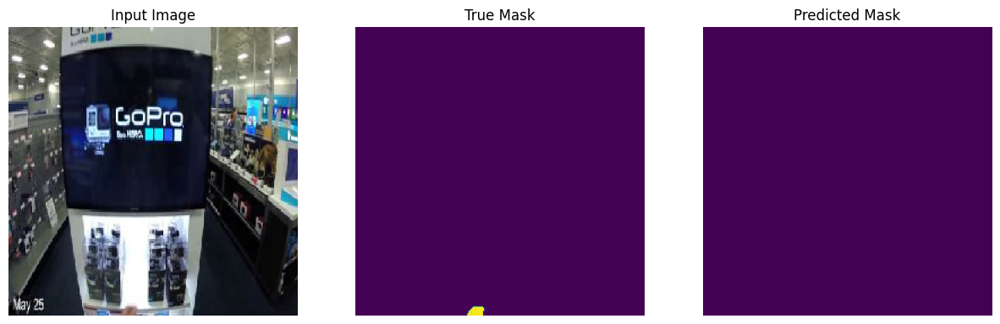

1/1 [==============================] - 0s 35ms/step


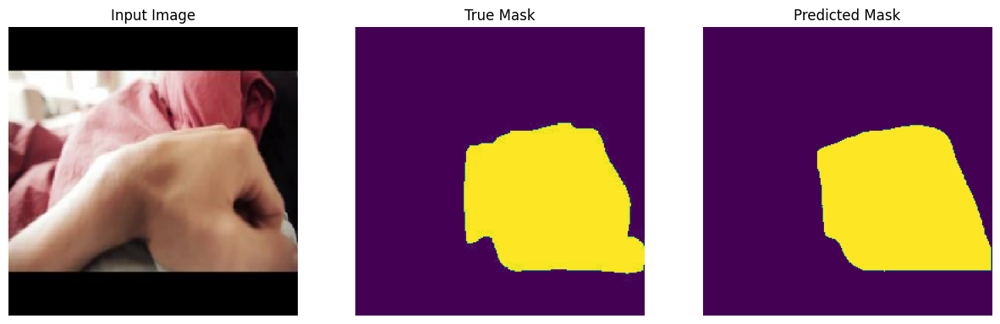

1/1 [==============================] - 0s 36ms/step


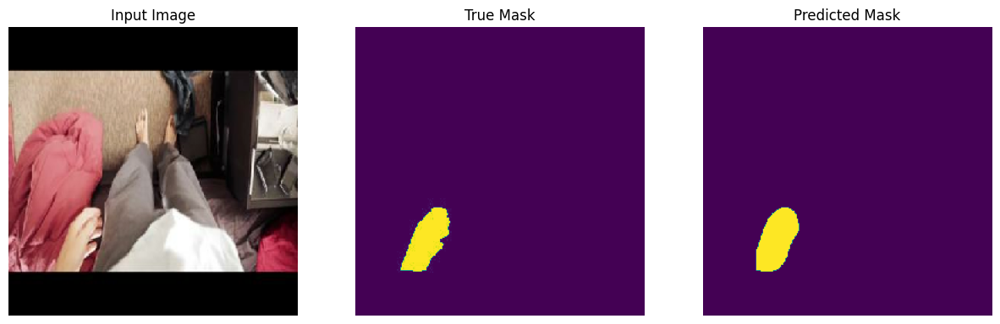

1/1 [==============================] - 0s 41ms/step


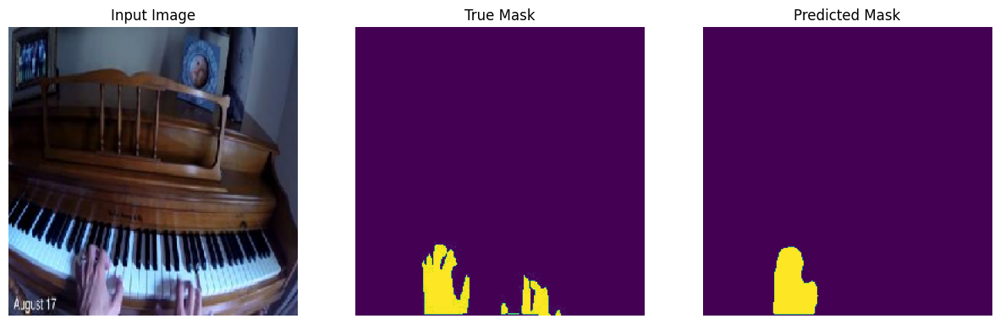

1/1 [==============================] - 0s 53ms/step


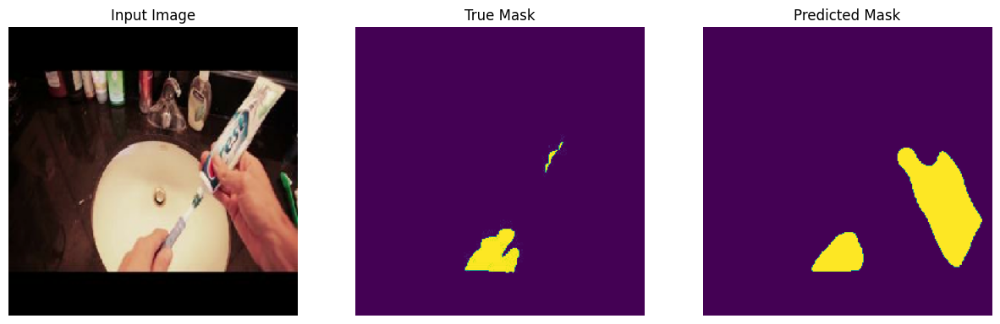

1/1 [==============================] - 0s 86ms/step


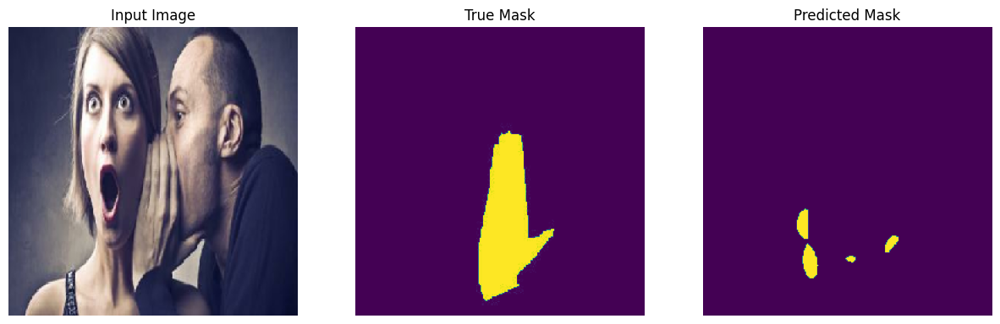

1/1 [==============================] - 0s 77ms/step


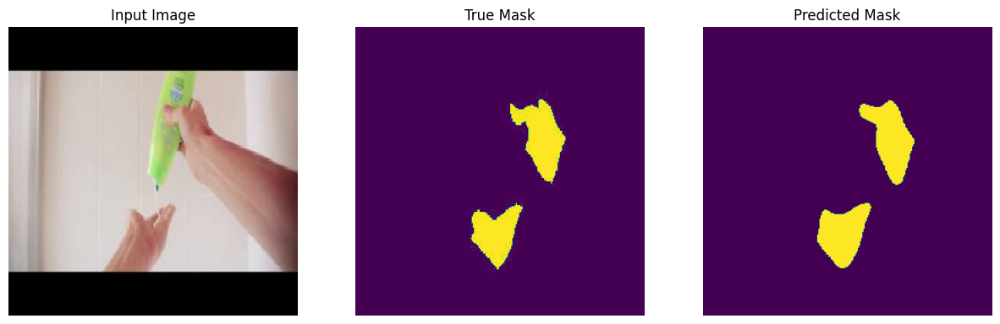

1/1 [==============================] - 0s 46ms/step


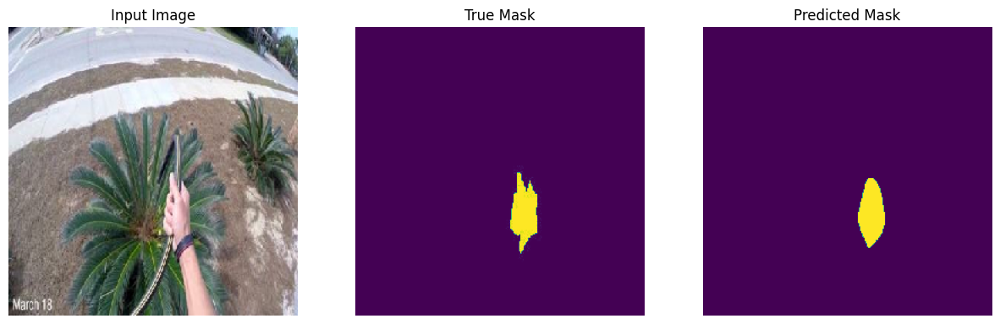

1/1 [==============================] - 0s 34ms/step


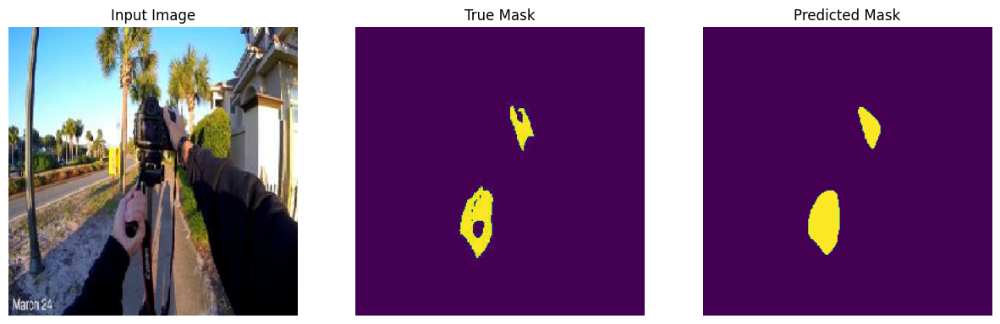

1/1 [==============================] - 0s 44ms/step


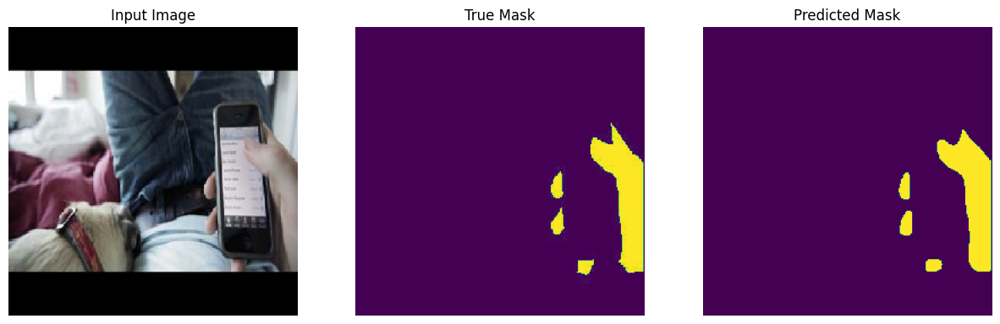

1/1 [==============================] - 0s 72ms/step


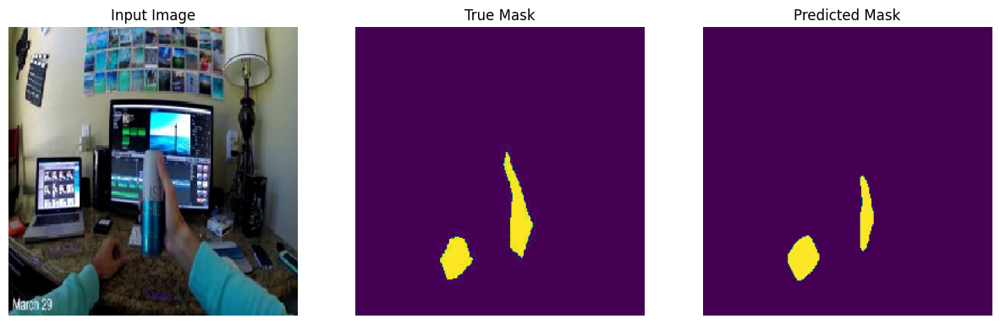

1/1 [==============================] - 0s 44ms/step


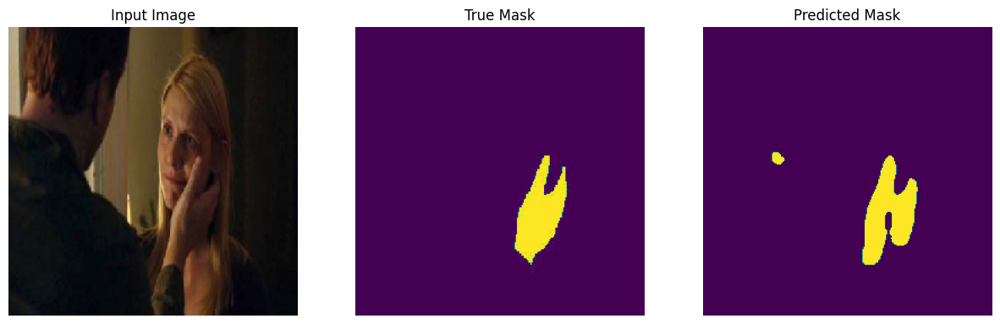

1/1 [==============================] - 0s 35ms/step


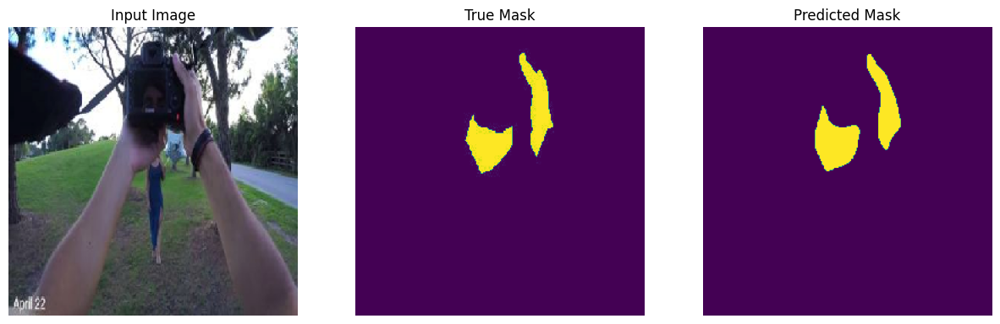

1/1 [==============================] - 0s 39ms/step


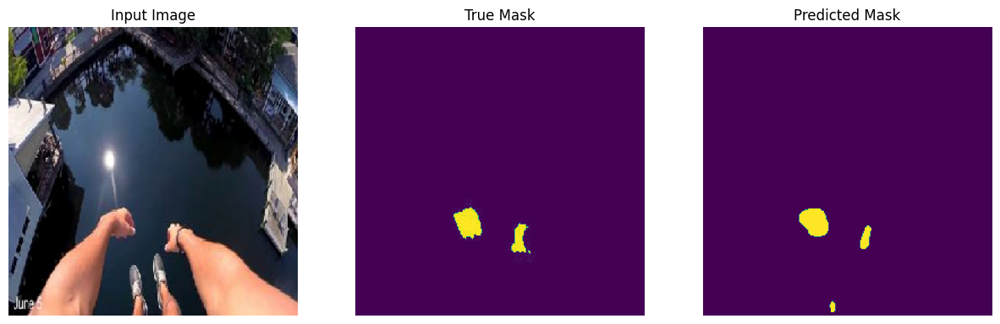

1/1 [==============================] - 0s 36ms/step


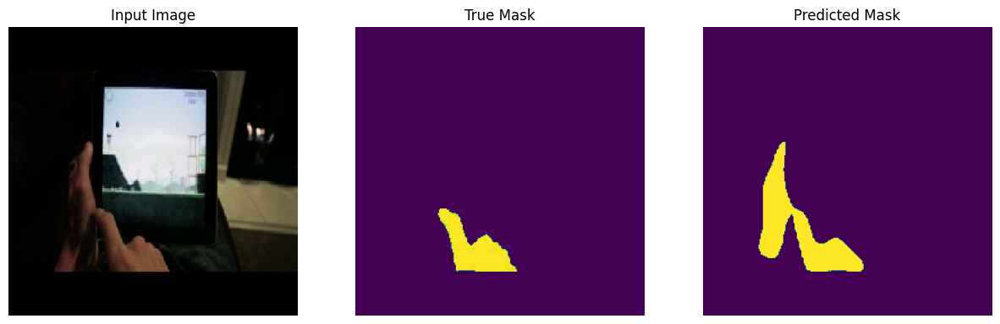

1/1 [==============================] - 0s 35ms/step


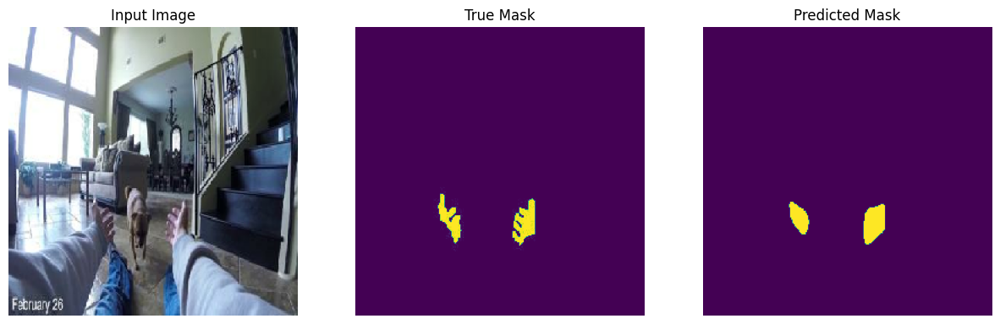

1/1 [==============================] - 0s 39ms/step


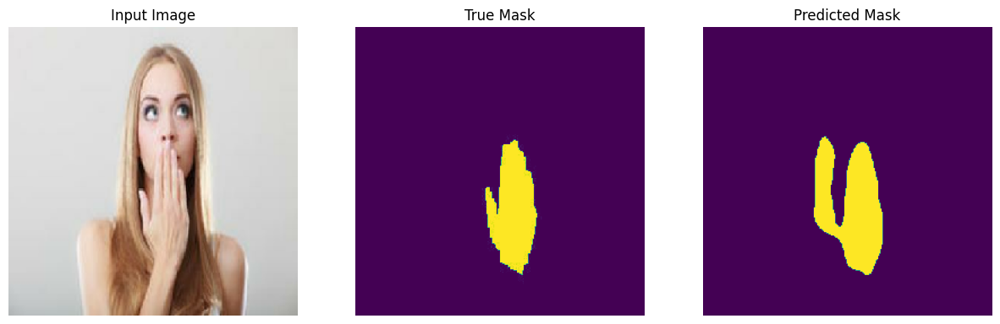

1/1 [==============================] - 0s 41ms/step


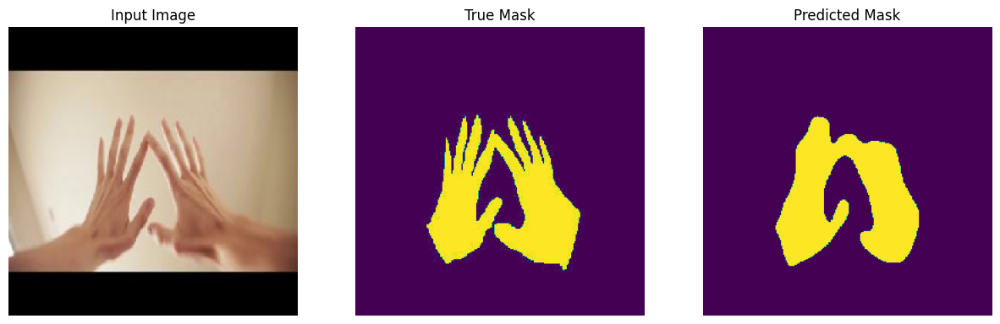

1/1 [==============================] - 0s 40ms/step


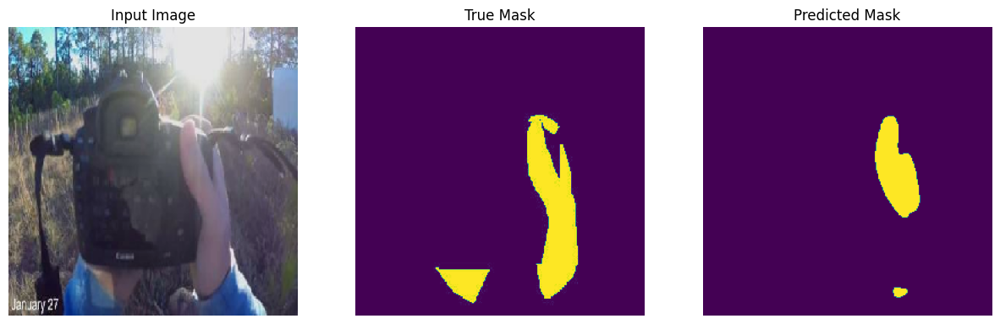

1/1 [==============================] - 0s 36ms/step


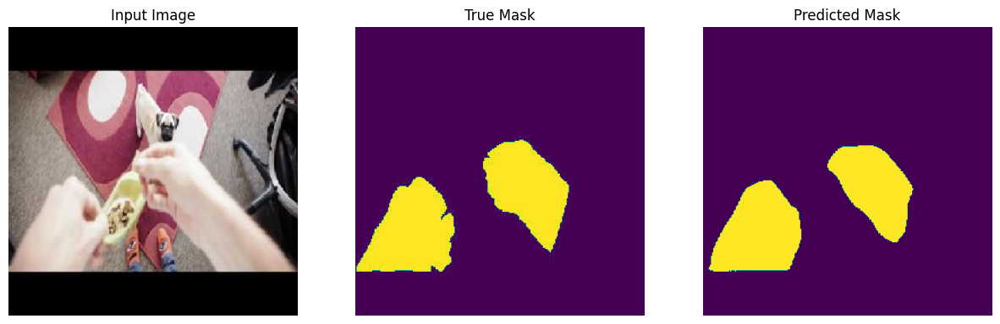

1/1 [==============================] - 0s 37ms/step


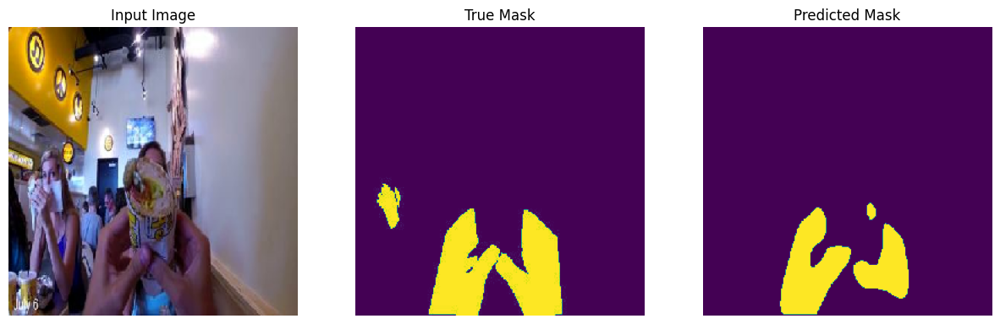

1/1 [==============================] - 0s 37ms/step


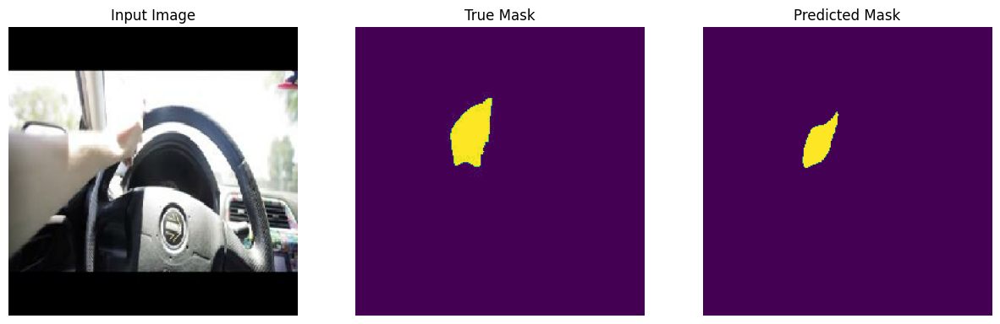

1/1 [==============================] - 0s 38ms/step


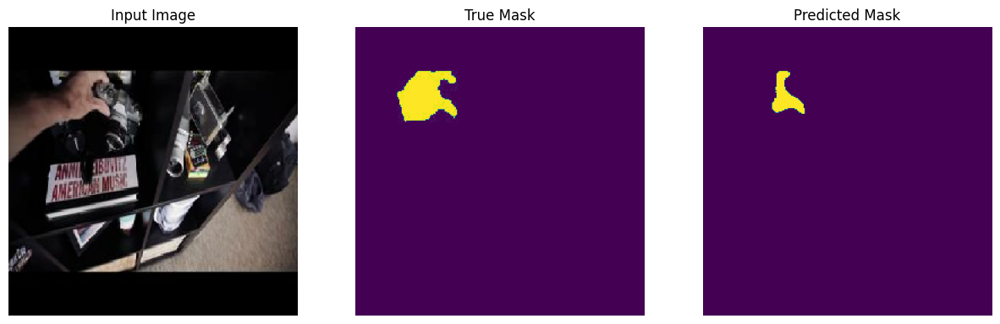

1/1 [==============================] - 0s 39ms/step


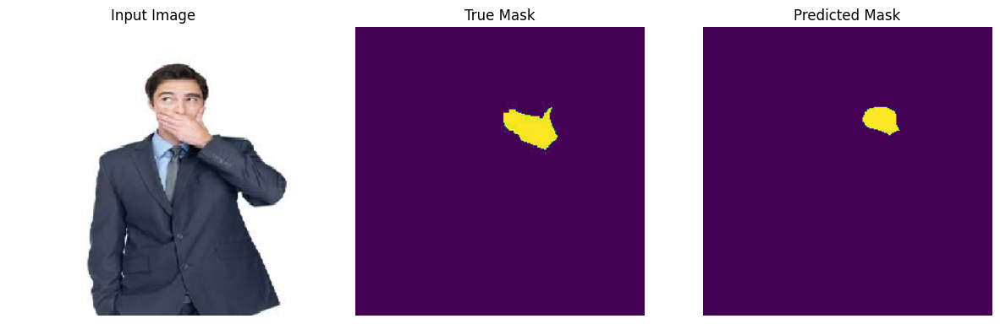

1/1 [==============================] - 0s 38ms/step


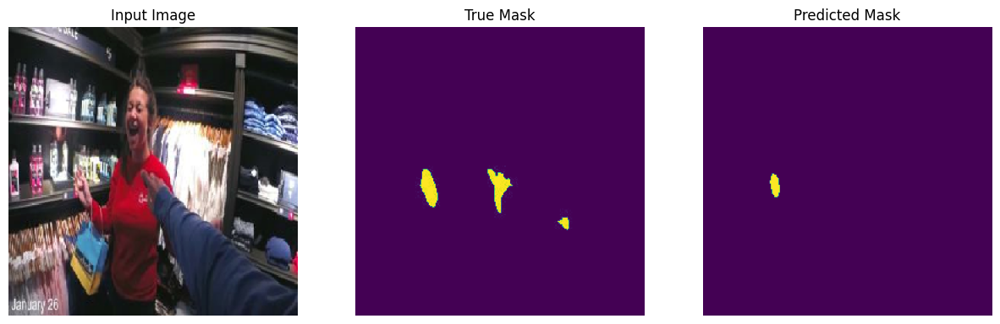

1/1 [==============================] - 0s 51ms/step


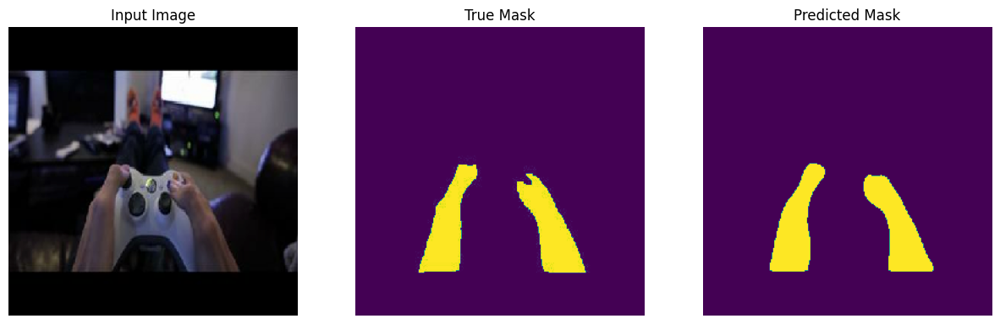

1/1 [==============================] - 0s 85ms/step


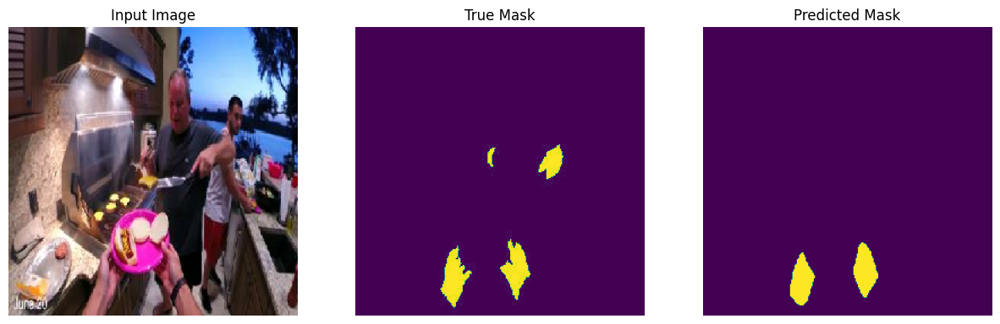

1/1 [==============================] - 0s 41ms/step


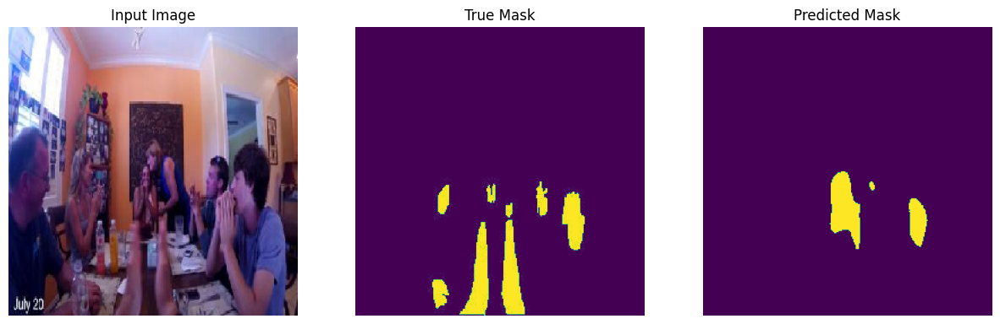

1/1 [==============================] - 0s 48ms/step


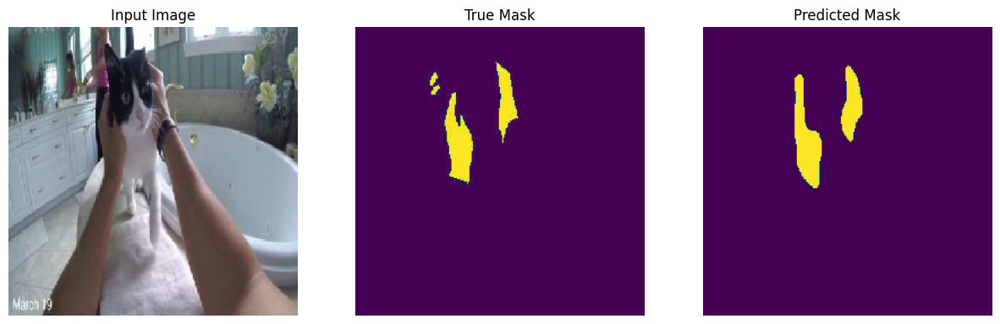

1/1 [==============================] - 0s 41ms/step


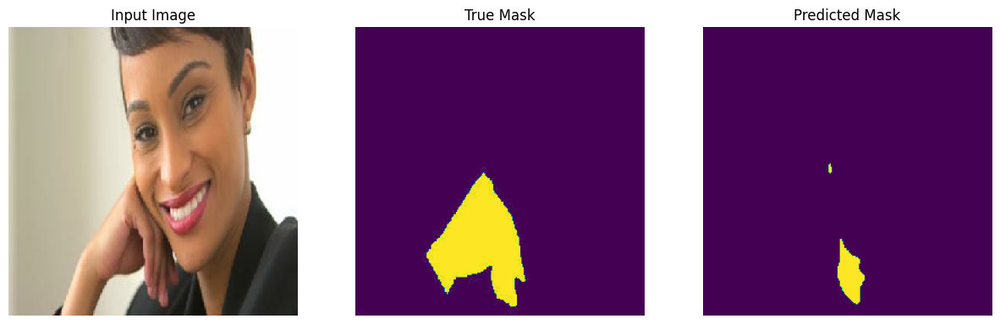

1/1 [==============================] - 0s 35ms/step


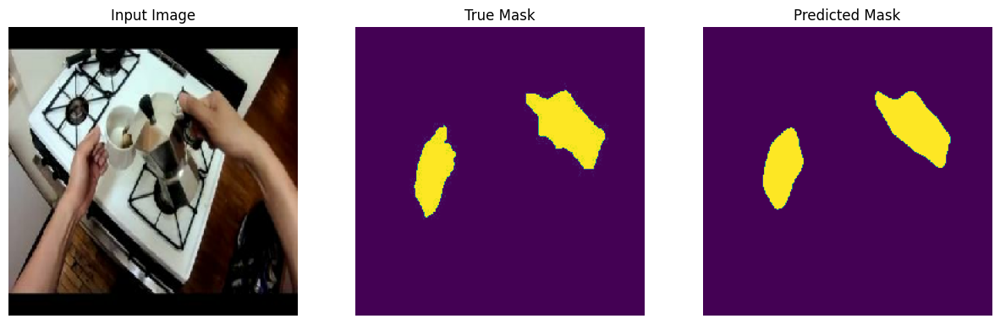

1/1 [==============================] - 0s 36ms/step


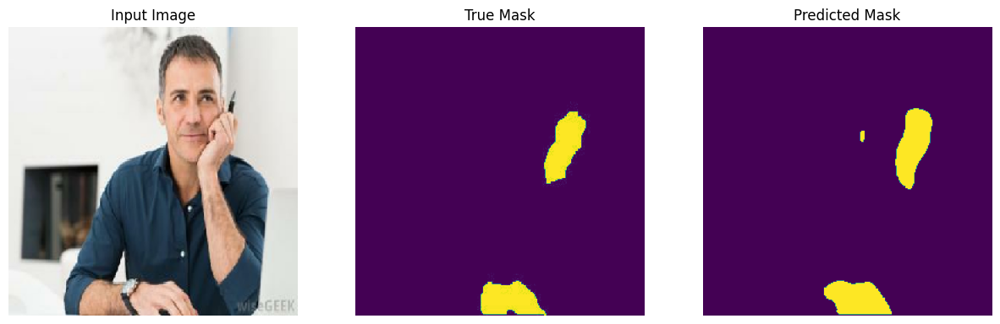

1/1 [==============================] - 0s 37ms/step


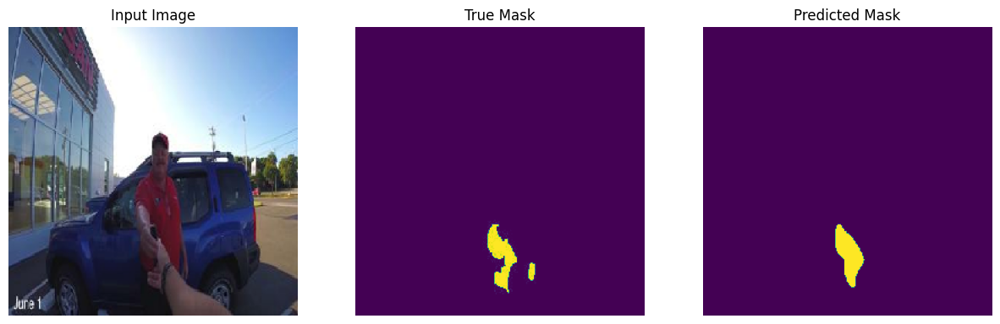

1/1 [==============================] - 0s 34ms/step


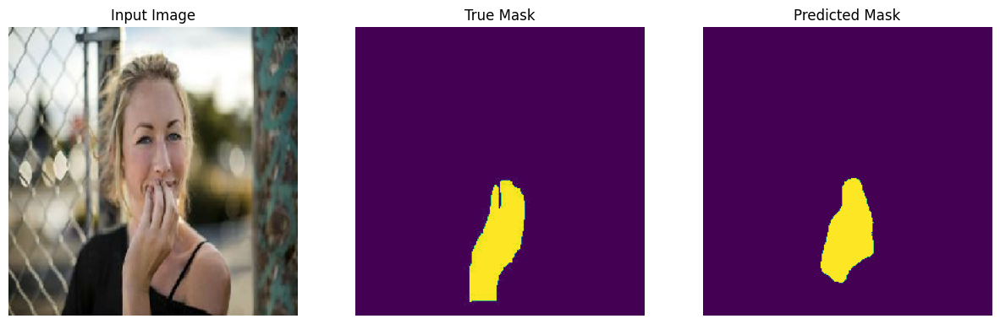

1/1 [==============================] - 0s 34ms/step


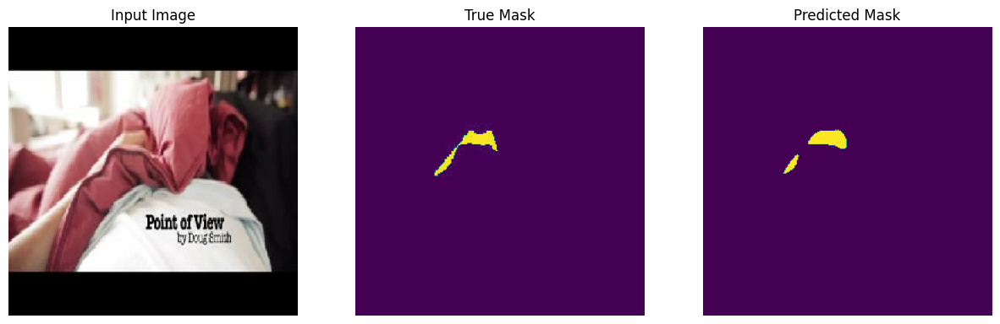

1/1 [==============================] - 0s 38ms/step


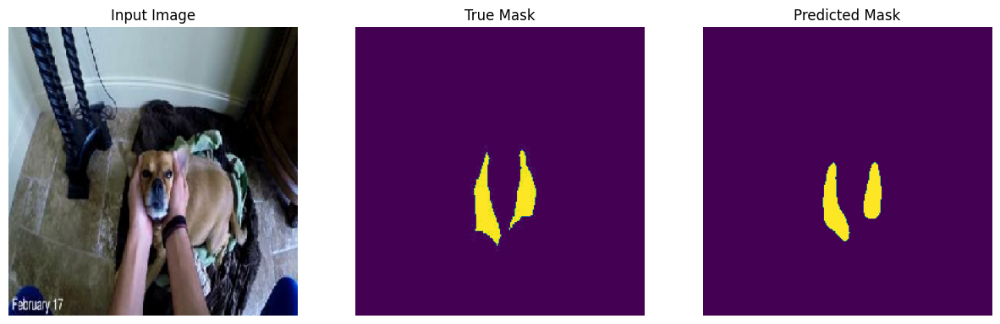

1/1 [==============================] - 0s 34ms/step


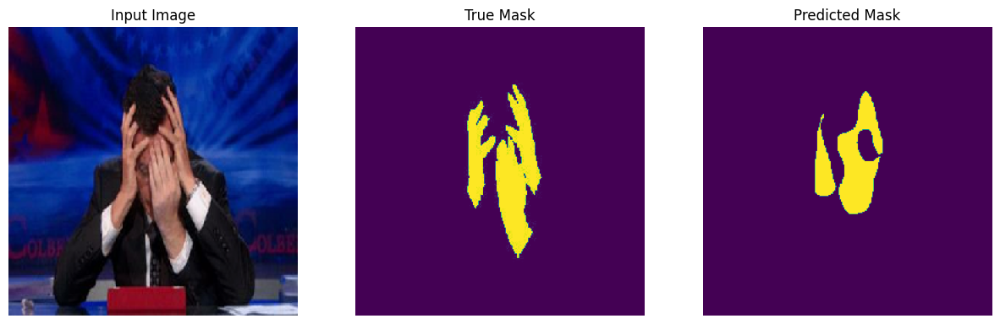

1/1 [==============================] - 0s 34ms/step


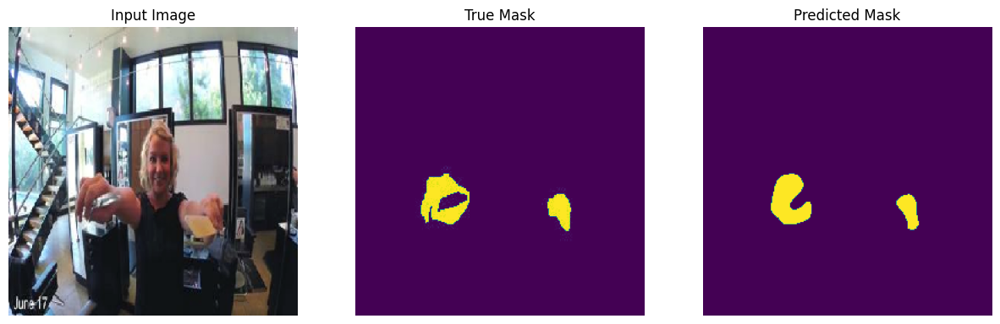

1/1 [==============================] - 0s 52ms/step


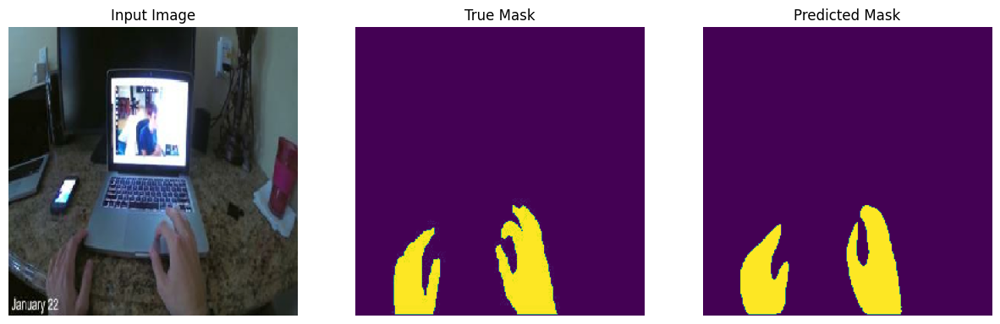

1/1 [==============================] - 0s 39ms/step


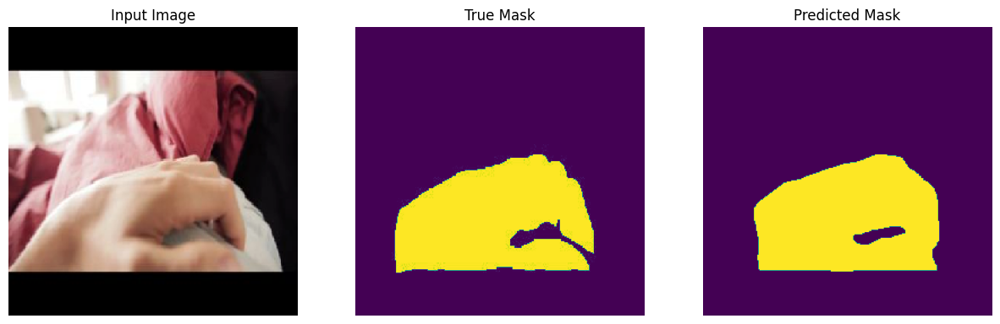

1/1 [==============================] - 0s 38ms/step


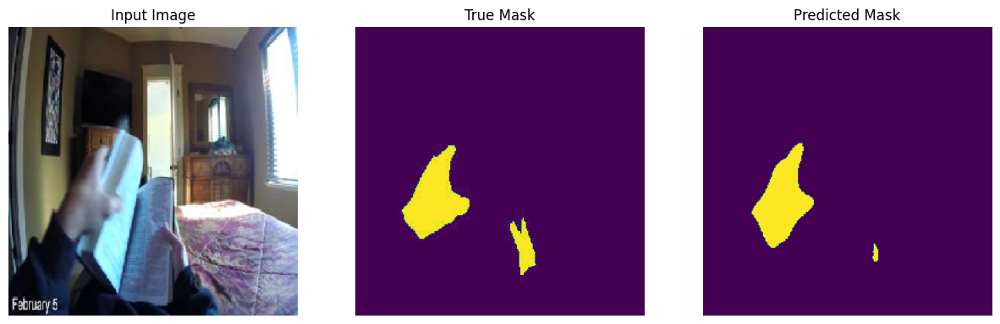

1/1 [==============================] - 0s 41ms/step


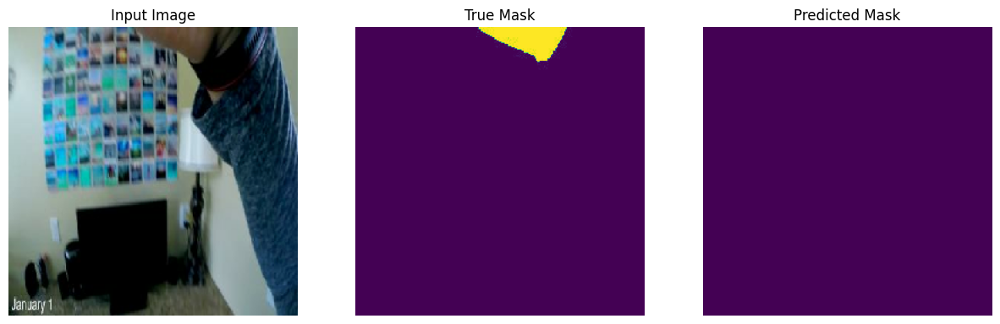

1/1 [==============================] - 0s 39ms/step


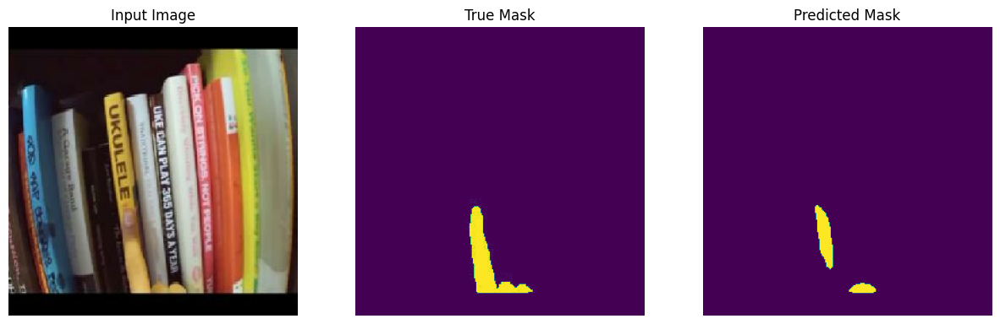

1/1 [==============================] - 0s 53ms/step


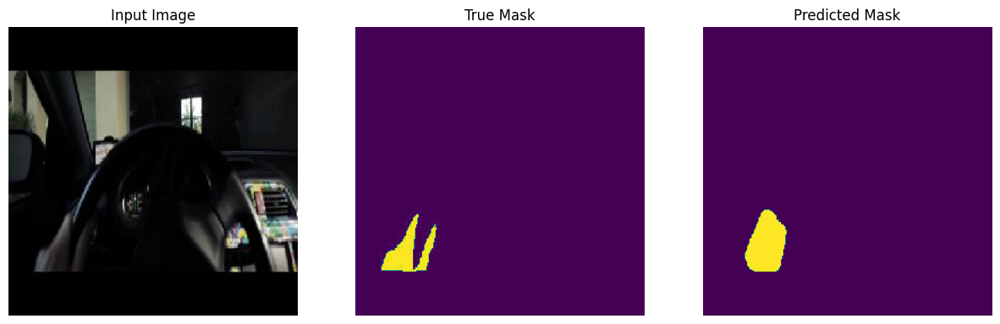

1/1 [==============================] - 0s 56ms/step


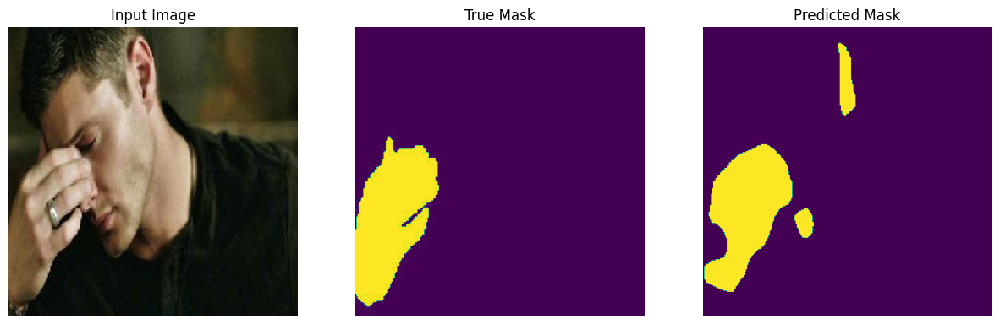

1/1 [==============================] - 0s 43ms/step


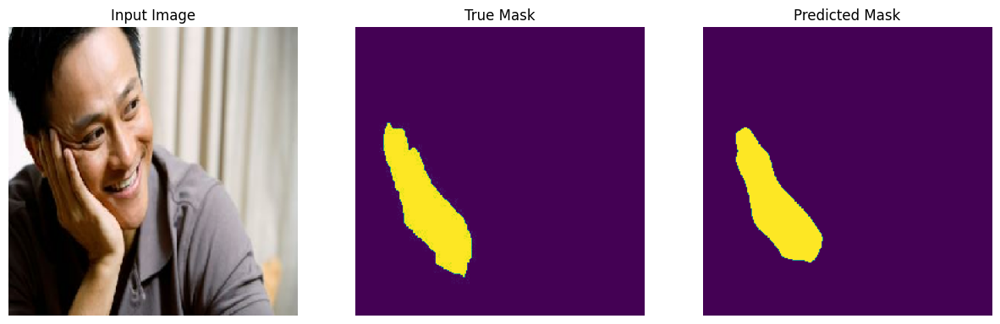

1/1 [==============================] - 0s 39ms/step


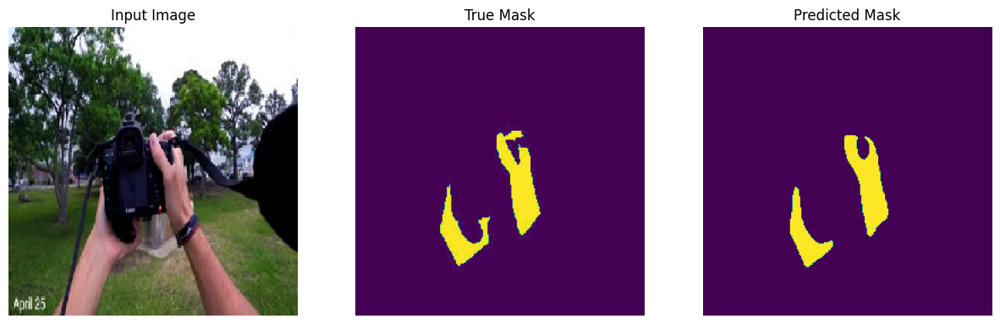

1/1 [==============================] - 0s 67ms/step


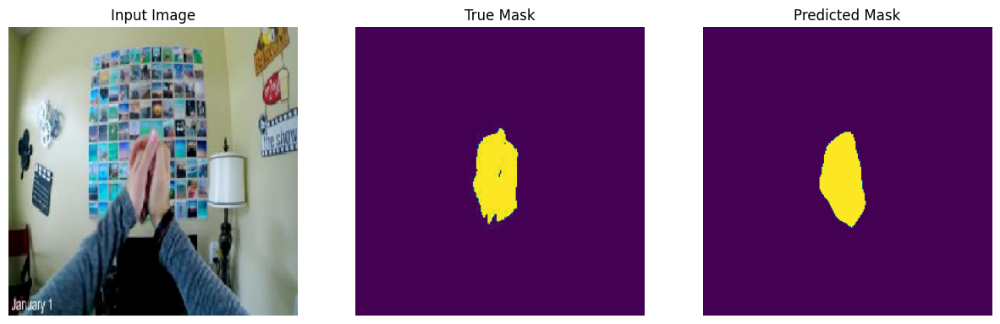

1/1 [==============================] - 0s 37ms/step


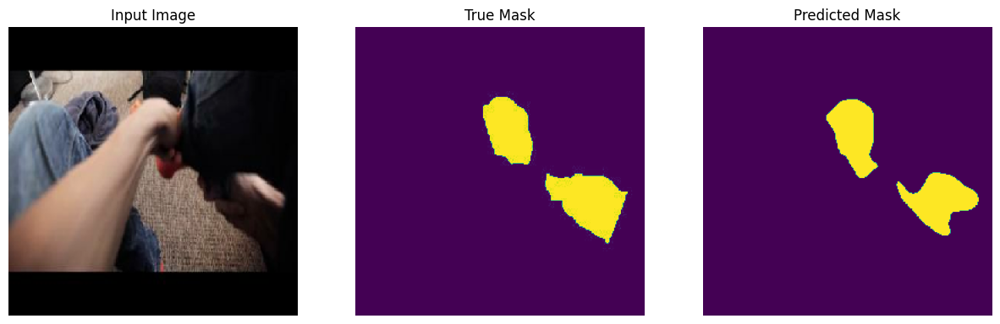

1/1 [==============================] - 0s 44ms/step


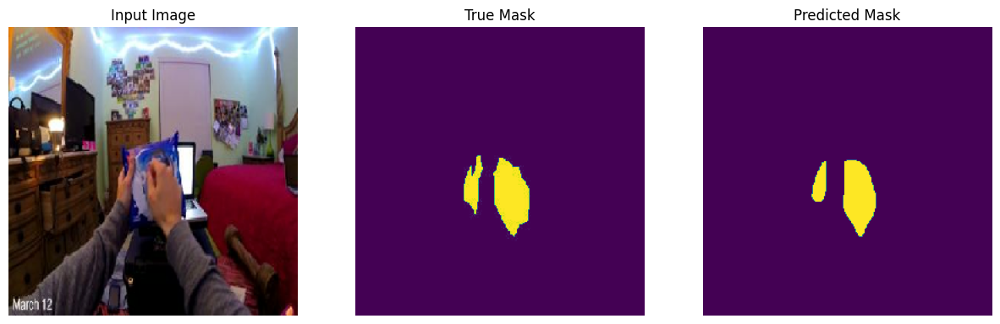

1/1 [==============================] - 0s 38ms/step


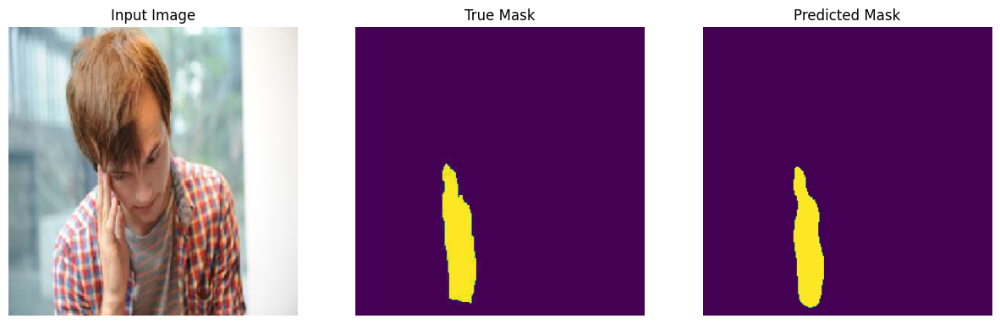

1/1 [==============================] - 0s 37ms/step


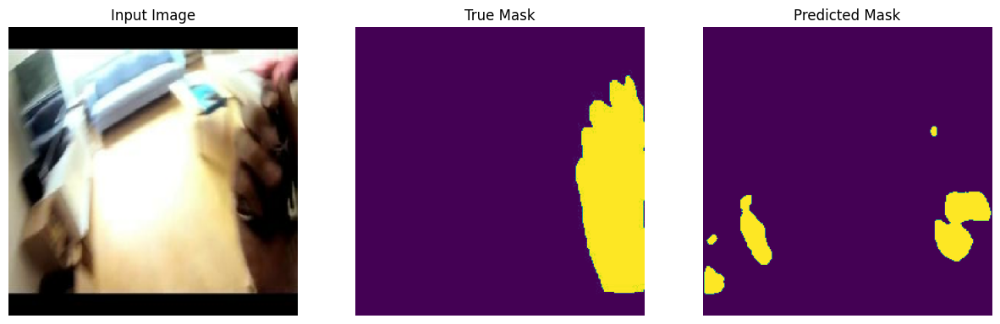

1/1 [==============================] - 0s 38ms/step


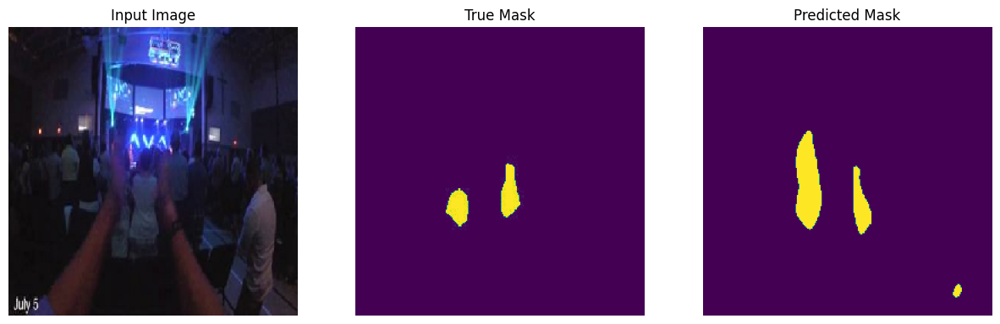

1/1 [==============================] - 0s 36ms/step


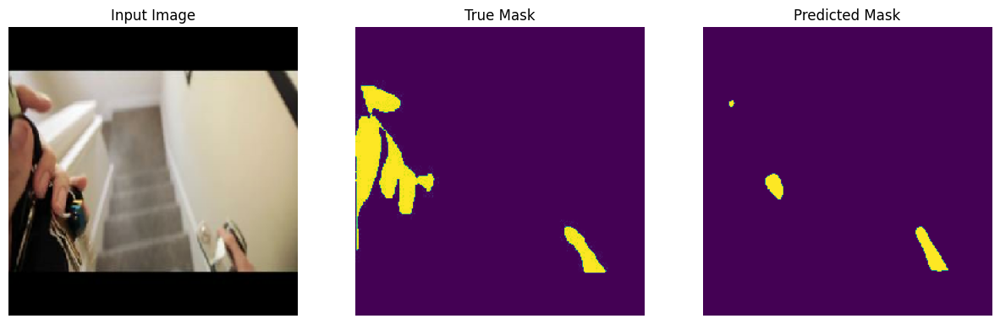

1/1 [==============================] - 0s 44ms/step


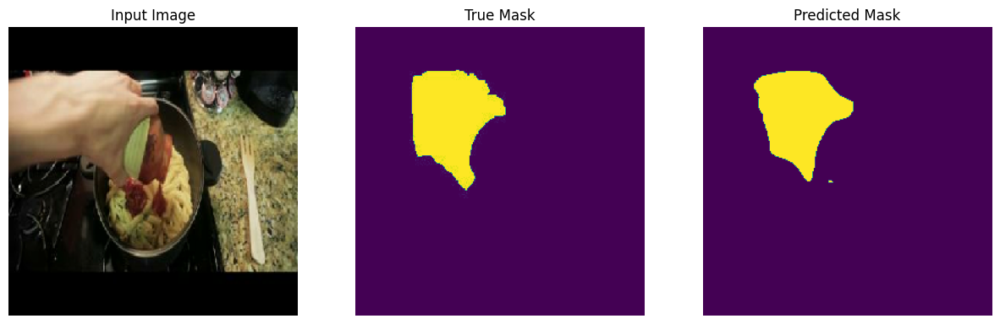

1/1 [==============================] - 0s 37ms/step


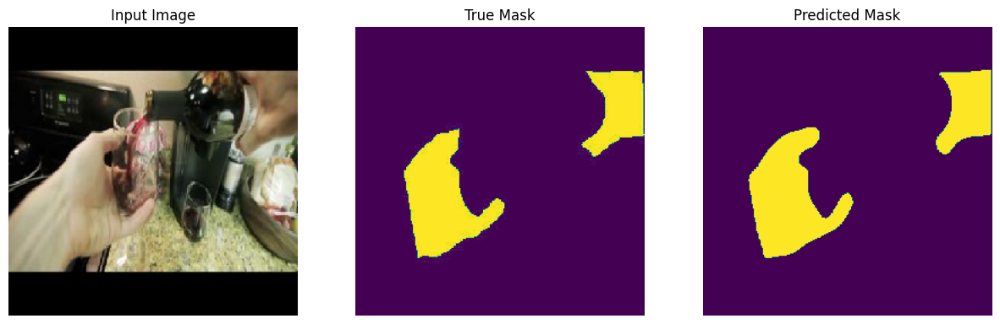

1/1 [==============================] - 0s 37ms/step


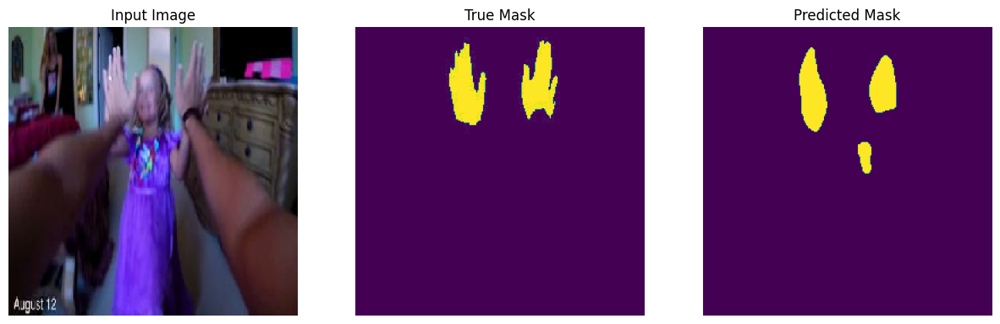

1/1 [==============================] - 0s 36ms/step


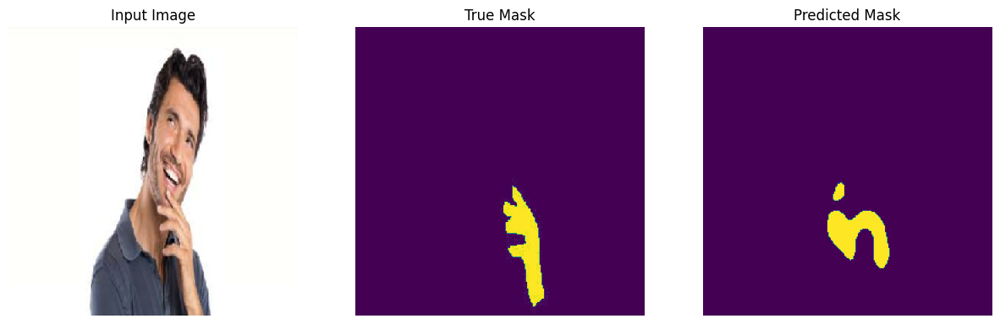

1/1 [==============================] - 0s 39ms/step


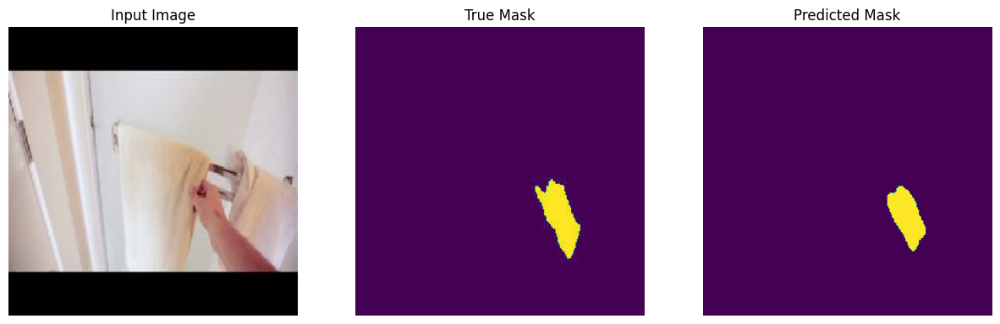

1/1 [==============================] - 0s 71ms/step


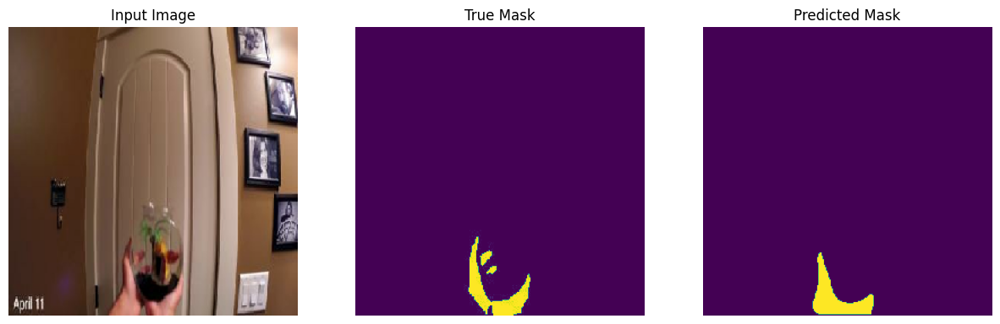

1/1 [==============================] - 0s 55ms/step


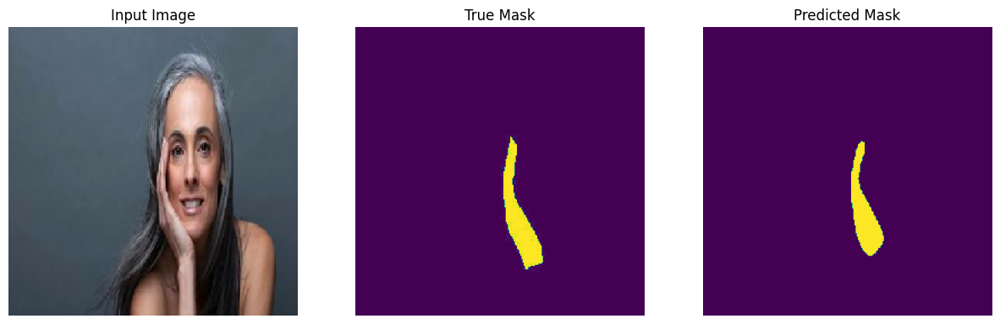

1/1 [==============================] - 0s 42ms/step


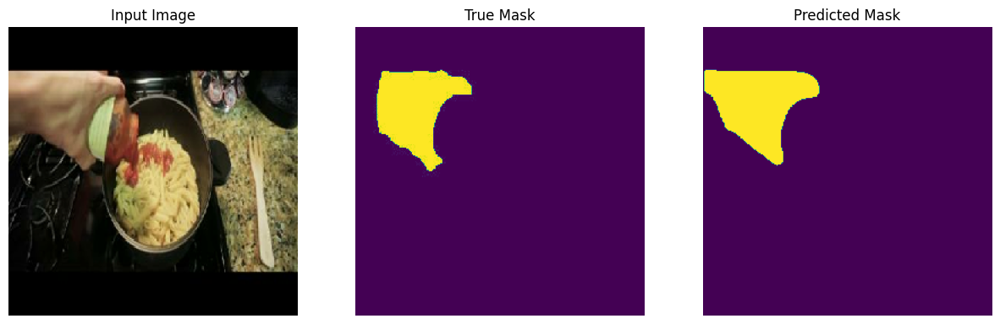

1/1 [==============================] - 0s 49ms/step


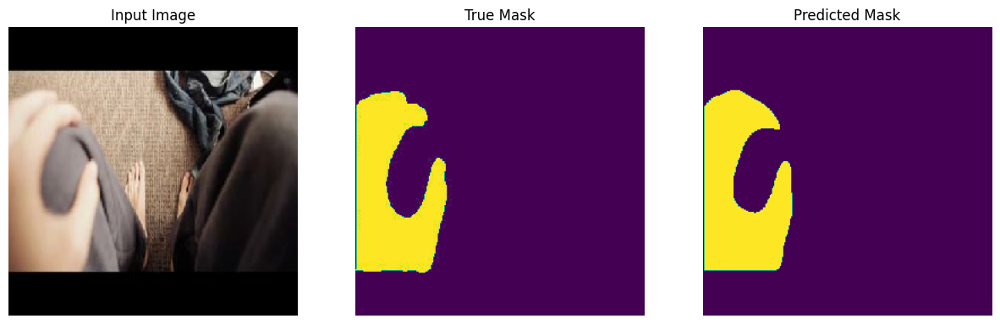

1/1 [==============================] - 0s 47ms/step


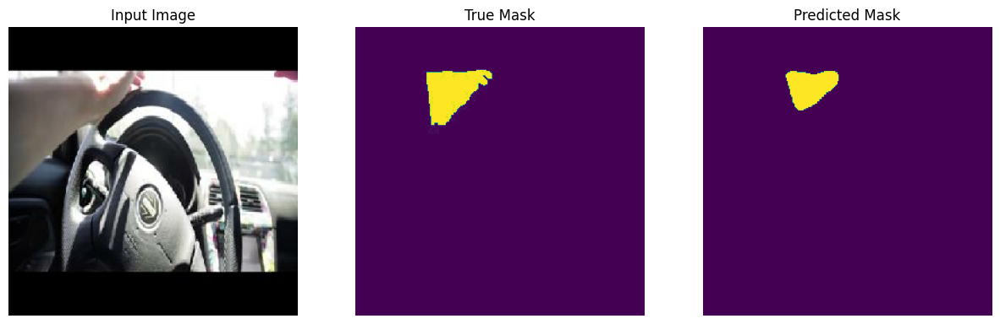

1/1 [==============================] - 0s 39ms/step


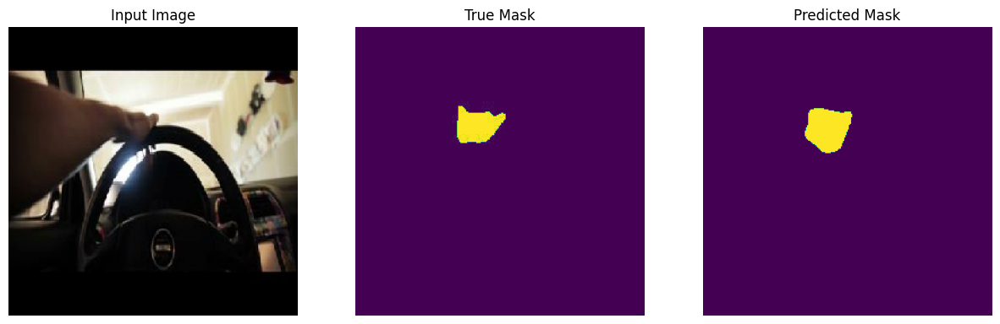

1/1 [==============================] - 0s 62ms/step


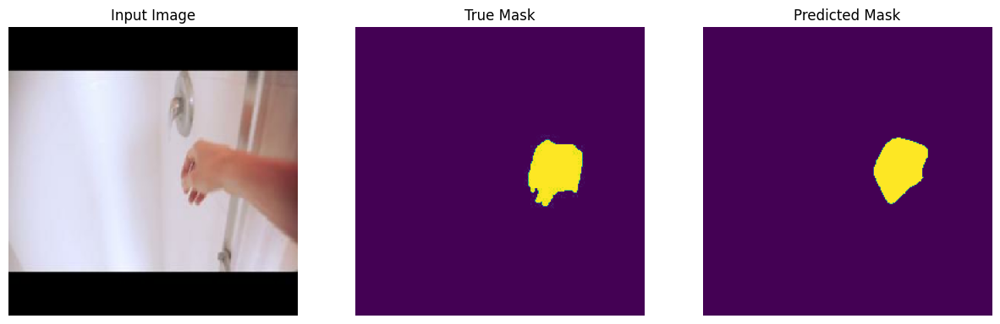

1/1 [==============================] - 0s 36ms/step


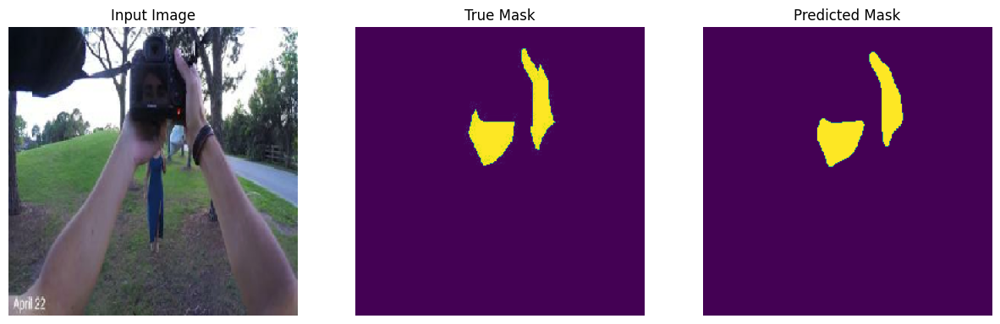

1/1 [==============================] - 0s 40ms/step


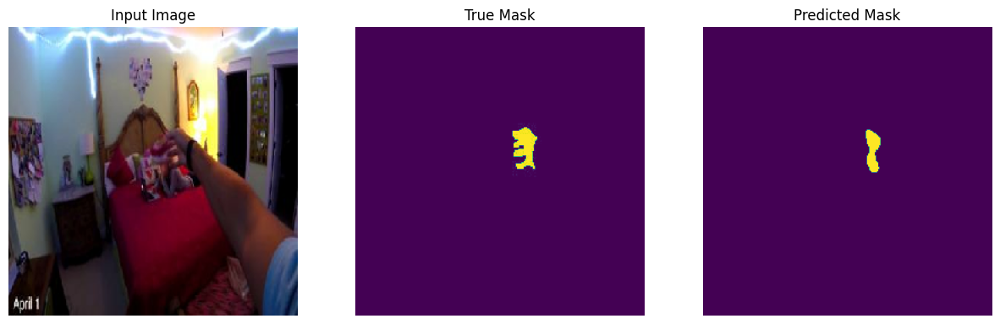

1/1 [==============================] - 0s 73ms/step


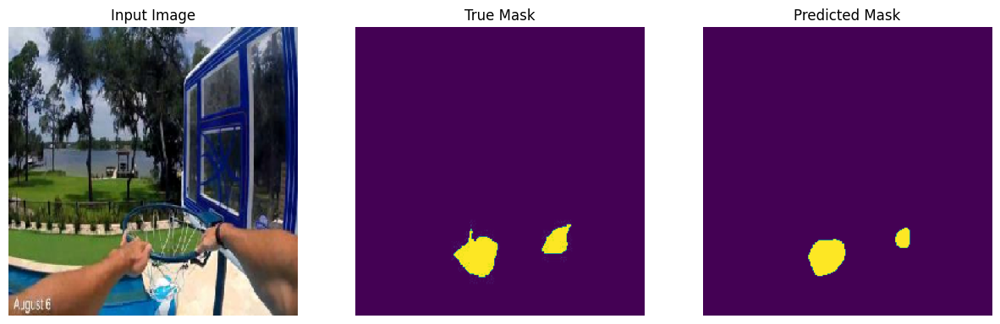

1/1 [==============================] - 0s 38ms/step


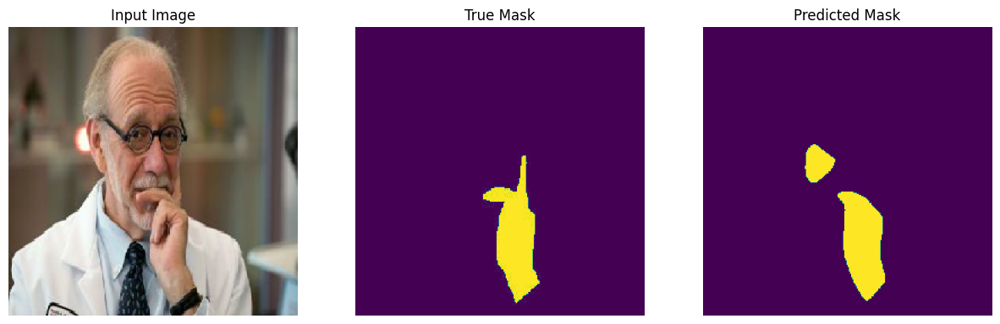

1/1 [==============================] - 0s 44ms/step


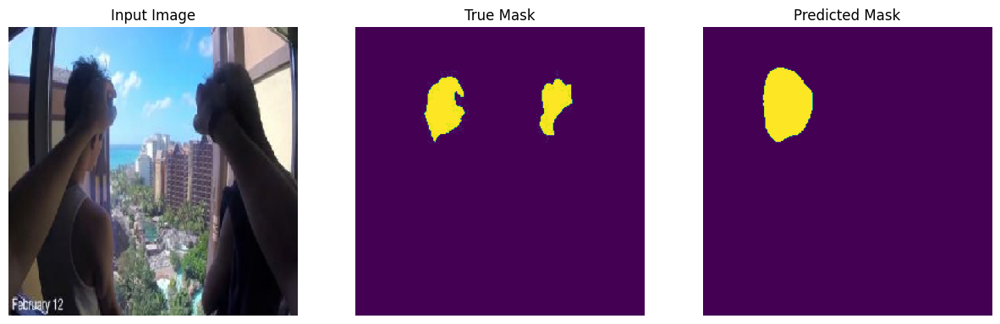

1/1 [==============================] - 0s 35ms/step


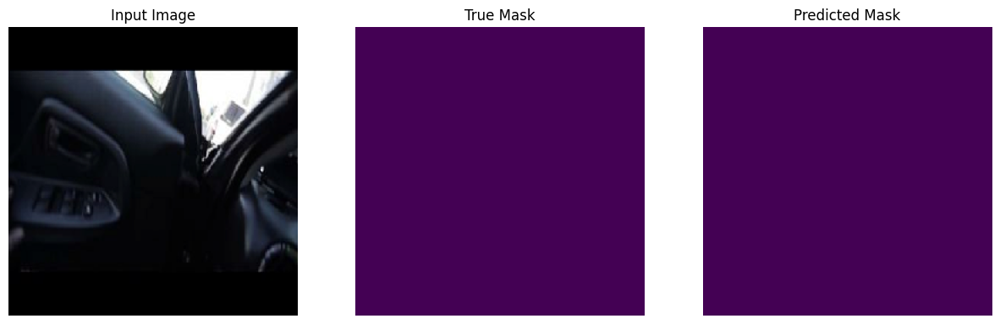

1/1 [==============================] - 0s 38ms/step


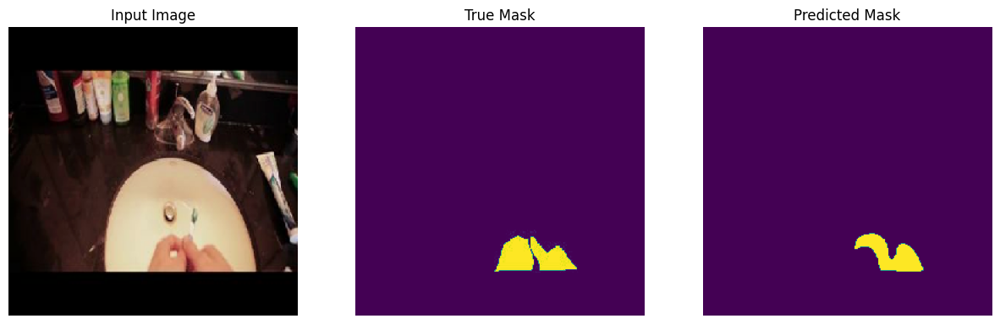

1/1 [==============================] - 0s 41ms/step


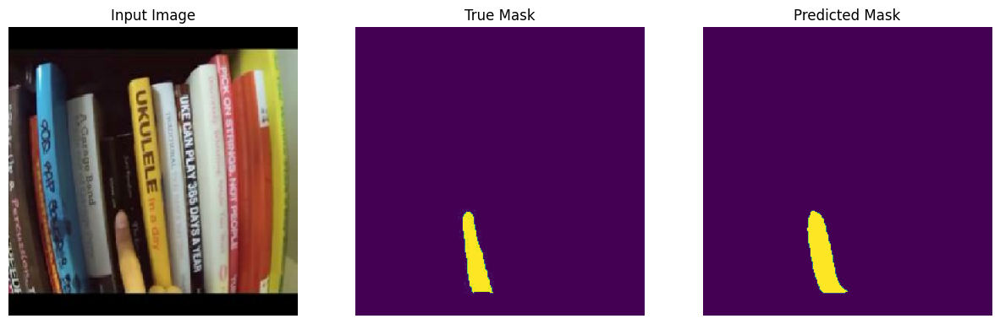

1/1 [==============================] - 0s 35ms/step


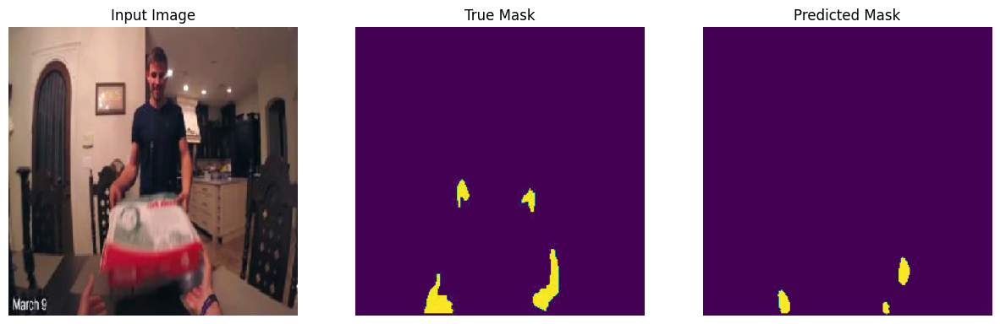

1/1 [==============================] - 0s 53ms/step


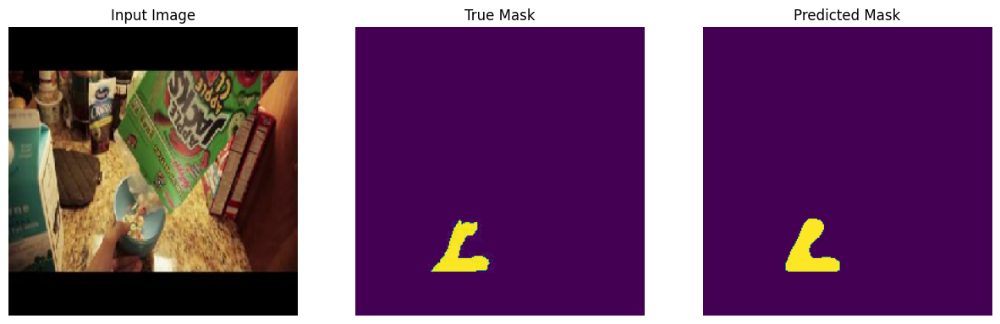

1/1 [==============================] - 0s 36ms/step


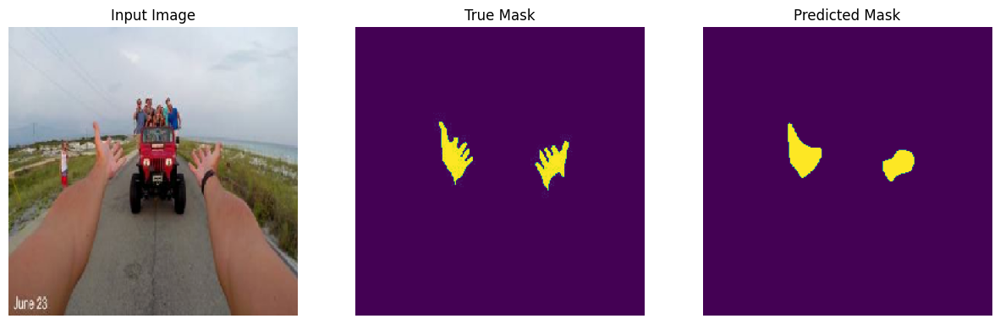

In [ ]:
#running inference on test set

test_dir = os.listdir('./split_dataset/test/images')
for img_name in test_dir:
  image_path = f'./split_dataset/test/images/{img_name}'
  #img = load_img(img_path, target_size=(512,512))
  mask_path = f'./split_dataset/test/masks/{img_name}'
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  image = tf.image.convert_image_dtype(image,dtype=tf.float32)
  mask = tf.io.read_file(mask_path)
  mask = tf.image.decode_jpeg(mask, channels=3)
  mask = mask[:,:,0]
  mask = tf.expand_dims(mask, axis=-1)
  mask = tf.image.convert_image_dtype(mask,dtype=tf.float32)
  input_image = tf.image.resize(image, (256, 256), method='nearest')
  input_mask = tf.image.resize(mask, (256, 256), method='nearest')
  input_image = input_image/ 255.0
  input_image =tf.expand_dims(input_image,axis=0)

  pred = model.predict(input_image)

  display([input_image[0],input_mask,create_mask(pred)])